In [1]:
%matplotlib inline


Transfer Learning for Computer
==============================================
**Reference**: `Sasank Chilamkurthy <https://chsasank.github.io>`_

These two major transfer learning scenarios look as follows:

-  **Finetuning the convnet**: Instead of random initializaion, we
   initialize the network with a pretrained network, like the one that is
   trained on imagenet 1000 dataset. The rest of the training looks as
   usual.
-  **ConvNet as fixed feature extractor**: Here, we will freeze the weights
   for all of the network except that of the final fully connected
   layer. This last fully connected layer is replaced with a new one
   with random weights and only this layer is trained.




In [2]:
# License: BSD
# Author: Ghassen Hamrouni

from __future__ import print_function
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
from torchvision import datasets, transforms, models
import matplotlib.pyplot as plt
import numpy as np
import os
from myImageFolder import MyImageFolder
import time
from sklearn import metrics
import copy
import pandas as pd
from PIL import Image, ImageDraw
from skimage.measure import label
import matplotlib.patches as patches

plt.ion()   # interactive mode

Load Data
---------

We will use torchvision and torch.utils.data packages for loading the
data.


In [18]:
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize(255),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225]),
    ]),
    'val': transforms.Compose([
        transforms.Resize(255),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225]),
    ]),
    'test': transforms.Compose([
        transforms.Resize(255),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225]),
    ]),


}

data_dir = '/home/kaiyihuang/nexperia/new_data'
image_datasets = {x: MyImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val', 'test']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=32,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val', 'test']}
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val', 'test']}
class_names = image_datasets['train'].classes

device = torch.device("cuda:3" if torch.cuda.is_available() else "cpu")

In [3]:
# ten-crop test

data_transforms = {
    'train': transforms.Compose([
        transforms.Resize(255),
        transforms.CenterCrop(224),
        transforms.RandomRotation(10),
        transforms.ColorJitter(0.2,0.2,0.2),
        transforms.RandomAffine(degrees=2, translate=(0.15,0.1),scale=(0.75,1.05)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225]),
    ]),
    'val': transforms.Compose([
        transforms.Resize(255),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225]),
    ]),
    'test': transforms.Compose([
        transforms.Resize(255),
        transforms.TenCrop(224),
        transforms.Lambda(lambda crops: torch.stack([transforms.ToTensor()(crop) for crop in crops])),
        transforms.Lambda(lambda tensors: torch.stack([transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225])(tensor) for tensor in tensors]))
    ])
}

data_dir = '/home/kaiyihuang/nexperia/new_data'
image_datasets = {x: MyImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val', 'test']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=32,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val', 'test']}
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val', 'test']}
class_names = image_datasets['train'].classes

device = torch.device("cuda:3" if torch.cuda.is_available() else "cpu")

In [15]:
# with data augmentation
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize(255),
        transforms.CenterCrop(224),
        transforms.RandomRotation(10),
        transforms.ColorJitter(0.2,0.2,0.2),
        transforms.RandomAffine(degrees=2, translate=(0.15,0.1),scale=(0.75,1.05)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225]),
    ]),
    'val': transforms.Compose([
        transforms.Resize(255),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225]),
    ]),
    'test': transforms.Compose([
        transforms.Resize(255),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225]),
    ]),


}

data_dir = '/home/kaiyihuang/nexperia/new_data'
image_datasets = {x: MyImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in ['train', 'val', 'test']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=32,
                                             shuffle=True, num_workers=4)
              for x in ['train', 'val', 'test']}
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val', 'test']}
class_names = image_datasets['train'].classes

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [63]:
# obtain bounding boxes
defect_details = pd.DataFrame(columns=['label', 'defect_1', 'defect_2', 'shape', 'x_1', 'y_1', 'x_2', 'y_2'])
for defect in image_datasets['test'].classes:
    if defect not in ['device_flip', 'empty_pocket', 'good']:
        file_name = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', defect,
                                 'ImageLabel.csv')
        table = pd.read_csv(file_name, names=['label', 'defect_2', 'shape', 'x_1', 'y_1', 'x_2', 'y_2'])
        table['defect_1'] = defect
        defect_details = defect_details.append(table)

defect_details = defect_details.set_index(['defect_1', 'label'])

Visualize a few images
^^^^^^^^^^^^^^^^^^^^^^
Let's visualize a few training images so as to understand the data
augmentations.



In [11]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.figure(figsize=(30,20))
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

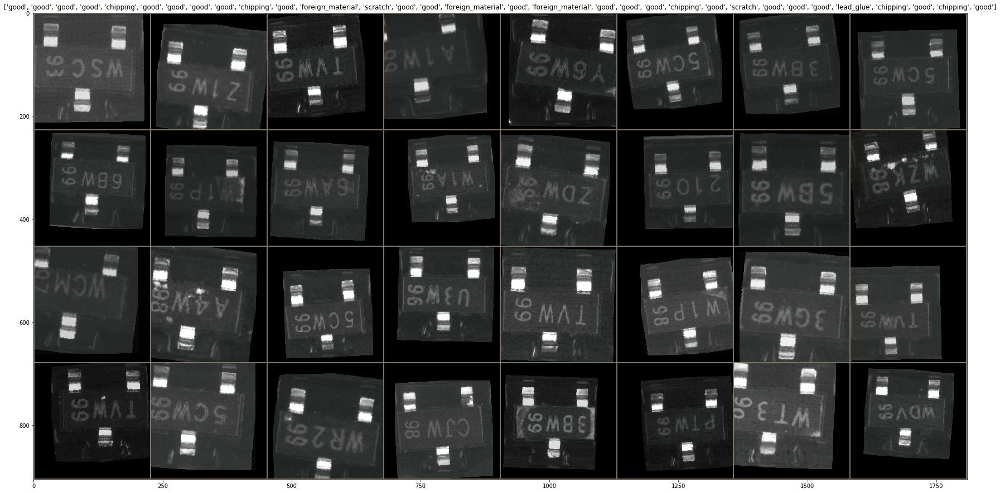

In [12]:
# Get a batch of training data
inputs, classes, image_id = next(iter(dataloaders['train']))

# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

imshow(out, title=[class_names[x] for x in classes])

Finetuning the convnet
----------------------

Load a pretrained model and reset final fully connected layer.




In [4]:
model_ft = models.resnet18(pretrained=True)
num_ftrs = model_ft.fc.in_features
# Here the size of each output sample is set to 10.
# Alternatively, it can be generalized to nn.Linear(num_ftrs, len(class_names)).
model_ft.fc = nn.Linear(num_ftrs, 10)

model = model_ft.to(device)

In [19]:
print(model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

Training the model
------------------

Now, let's write a general function to train a model. Here, we will
illustrate:

-  Scheduling the learning rate
-  Saving the best model

In the following, parameter ``scheduler`` is an LR scheduler object from
``torch.optim.lr_scheduler``.



In [13]:
def train(epoch, model):    
    model.train()
    train_loss = 0
    y_true = []
    y_score = []
    image_ids = []
    for batch_idx, (data, target, image_id) in enumerate(dataloaders['train']):
        data, target = data.to(device), target.to(device)

        optimizer.zero_grad()
        output = model(data)
        loss = F.cross_entropy(output, target)
        loss.backward()
        optimizer.step()
        train_loss += loss * len(target)
        
        probs = F.softmax(output, dim=1)
        
        y_true.append(target.detach().to('cpu'))
        y_score.append(probs.detach().to('cpu'))
        image_ids.append(image_id)
        
    train_loss /= len(image_datasets['train'])
    
    y_true = torch.cat(y_true)
    y_score = torch.cat(y_score)

    auc = metrics.roc_auc_score(y_true!=4, 1.-y_score[:,4])
    
    print('Train Epoch{} - Average Loss: {:.6f}, AUC: {:.4f}%'.format(
        epoch, loss.item(), auc*100.))
    return loss.item(), auc, model

def eval_train_data(model):    
    model.eval()
    train_loss = 0
    y_true = []
    y_score = []
    image_ids = []
    for batch_idx, (data, target, image_id) in enumerate(dataloaders['test']):
        data, target = data.to(device), target.to(device)

        optimizer.zero_grad()
        output = model(data)
        loss = F.cross_entropy(output, target)
        loss.backward()
        optimizer.step()
        train_loss += loss * len(target)
        
        probs = F.softmax(output, dim=1)
        
        y_true.append(target.detach().to('cpu'))
        y_score.append(probs.detach().to('cpu'))
        image_ids.append(image_id)
        
    train_loss /= len(image_datasets['train'])
    
    y_true = torch.cat(y_true)
    y_score = torch.cat(y_score)

    auc = metrics.roc_auc_score(y_true!=4, 1.-y_score[:,4])

    print('Train average Loss: {:.6f}, AUC: {:.4f}%'.format(
        loss.item(), auc*100.))
    return y_true, y_score, image_ids, loss.item(), auc

def test(model):
    with torch.no_grad():
        model.eval()
        test_loss = 0
        correct = 0
        y_true = []
        y_score = []
        image_ids = []
        for data, target, image_id in dataloaders['test']:
            data, target = data.to(device), target.to(device)
            output = model(data)

            # sum up batch loss
            test_loss += F.cross_entropy(output, target, reduction='sum').item()
            
            probs = F.softmax(output, dim=1)
            
            y_true.append(target.detach().to('cpu'))
            y_score.append(probs.detach().to('cpu'))
            image_ids.append(image_id)

        test_loss /= len(image_datasets['test'])
        
        probs = F.softmax(output, dim=1)
        
        y_true.append(target.detach().to('cpu'))
        y_score.append(probs.detach().to('cpu'))
        
        y_true = torch.cat(y_true)
        y_score = torch.cat(y_score)
        
        auc = metrics.roc_auc_score(y_true!=4, 1.-y_score[:,4])

        print('Test set - Average loss: {:.4f}, AUC: {:.4f}%'
              .format(test_loss, auc*100.))
        return y_true, y_score, image_ids, auc, test_loss

def val(model):
    with torch.no_grad():
        model.eval()
        val_loss = 0
        correct = 0
        y_true = []
        y_score = []
        image_ids = []
        for data, target, image_id in dataloaders['val']:
            data, target = data.to(device), target.to(device)
            output = model(data)

            # sum up batch loss
            val_loss += F.cross_entropy(output, target, reduction='sum').item()
            
            probs = F.softmax(output, dim=1)
            
            y_true.append(target.detach().to('cpu'))
            y_score.append(probs.detach().to('cpu'))
            image_ids.append(image_id)

        val_loss /= len(image_datasets['val'])
        
        probs = F.softmax(output, dim=1)
        
        y_true.append(target.detach().to('cpu'))
        y_score.append(probs.detach().to('cpu'))
        
        y_true = torch.cat(y_true)
        y_score = torch.cat(y_score)
        
        auc = metrics.roc_auc_score(y_true!=4, 1.-y_score[:,4])

        print('Val set - Average loss: {:.4f}, AUC: {:.4f}%\n'
              .format(val_loss, auc*100.))
        return y_true, y_score, image_ids, auc, val_loss

In [5]:
def test_ten_crop(model):
    with torch.no_grad():
        model.eval()
        test_loss = 0
        correct = 0
        y_true = []
        y_score = []
        image_ids = []
        for data, target, image_id in dataloaders['test']:
            data, target = data.to(device), target.to(device)
            bs, ncrops, c, h, w = data.size()
            
            output = model(data.view(-1, c, h, w)).view(bs, ncrops, -1).mean(1)

            # sum up batch loss
            test_loss += F.cross_entropy(output, target, reduction='sum').item()
            
            probs = F.softmax(output, dim=1)
            
            y_true.append(target.detach().to('cpu'))
            y_score.append(probs.detach().to('cpu'))
            image_ids.append(image_id)

        test_loss /= len(image_datasets['test'])
        
        probs = F.softmax(output, dim=1)
        
        y_true.append(target.detach().to('cpu'))
        y_score.append(probs.detach().to('cpu'))
        
        y_true = torch.cat(y_true)
        y_score = torch.cat(y_score)
        
        auc = metrics.roc_auc_score(y_true!=4, 1.-y_score[:,4])

        print('Test set - Average loss: {:.4f}, AUC: {:.4f}%'
              .format(test_loss, auc*100.))
        return y_true, y_score, image_ids, auc, test_loss

In [6]:
# batch_size=32, without data augmentation
optimizer = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

exp_lr_scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

since = time.time()

best_model_wts = [copy.deepcopy(model.state_dict())]*10
best_auc = np.zeros(10)
best_epoch = 0
train_losses = []
val_losses = []
train_aucs = []
val_aucs = []

for epoch in range(1, 50 + 1):
    train_loss, train_auc, model = train(epoch, model)
    exp_lr_scheduler.step()
    y_true, y_score, image_id, val_auc, val_loss = val(model)
    
    train_losses.append(train_loss)
    train_aucs.append(train_auc)
    val_losses.append(val_loss)
    val_aucs.append(val_auc)
        
    if val_auc > np.min(best_auc):
        if val_auc > np.max(best_auc):
            best_epoch = epoch
            best_y_true, best_y_score, best_image_id = y_true, y_score, image_id
        min_idx = np.argmin(best_auc)
        best_auc[min_idx] = val_auc
        best_model_wts[min_idx] = copy.deepcopy(model.state_dict())

time_elapsed = time.time() - since
print('Training complete in {:.0f}m {:.0f}s'.format(
    time_elapsed // 60, time_elapsed % 60))
print('Best epoch: {:d}'.format(best_epoch))
print('Best AUC: {:4f}%'.format(np.max(best_auc)*100))

Train Epoch1 - Average Loss: 0.220368, AUC: 97.3724%
Val set - Average loss: 0.1688, AUC: 99.6550%

Train Epoch2 - Average Loss: 0.652045, AUC: 99.7728%
Val set - Average loss: 0.1464, AUC: 99.7431%

Train Epoch3 - Average Loss: 0.154434, AUC: 99.9659%
Val set - Average loss: 0.1296, AUC: 99.8158%

Train Epoch4 - Average Loss: 0.003217, AUC: 99.9937%
Val set - Average loss: 0.1425, AUC: 99.7689%

Train Epoch5 - Average Loss: 0.001943, AUC: 99.9989%
Val set - Average loss: 0.1487, AUC: 99.8131%

Train Epoch6 - Average Loss: 0.001199, AUC: 99.9991%
Val set - Average loss: 0.1570, AUC: 99.7942%

Train Epoch7 - Average Loss: 0.001525, AUC: 99.9997%
Val set - Average loss: 0.1612, AUC: 99.8077%

Train Epoch8 - Average Loss: 0.012506, AUC: 100.0000%
Val set - Average loss: 0.1663, AUC: 99.8164%

Train Epoch9 - Average Loss: 0.000593, AUC: 100.0000%
Val set - Average loss: 0.1651, AUC: 99.8213%

Train Epoch10 - Average Loss: 0.000694, AUC: 100.0000%
Val set - Average loss: 0.1646, AUC: 99.820

In [6]:
# batch_size=32, with data augmentation
optimizer = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

exp_lr_scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

since = time.time()

best_model_wts = copy.deepcopy(model.state_dict())
best_auc = 0
best_epoch = 0
train_losses = []
val_losses = []
train_aucs = []
val_aucs = []

for epoch in range(1, 50 + 1):
    train_loss, train_auc, model = train(epoch, model)
    exp_lr_scheduler.step()
    y_true, y_score, image_id, val_auc, val_loss = val(model)
    
    train_losses.append(train_loss)
    train_aucs.append(train_auc)
    val_losses.append(val_loss)
    val_aucs.append(val_auc)
        
    if val_auc > best_auc:
        best_model_wts = copy.deepcopy(model.state_dict())
        best_epoch = epoch
        best_y_true, best_y_score, best_image_id, best_auc = y_true, y_score, image_id, val_auc

time_elapsed = time.time() - since
print('Training complete in {:.0f}m {:.0f}s'.format(
    time_elapsed // 60, time_elapsed % 60))
print('Best epoch: {:d}'.format(best_epoch))
print('Best AUC: {:4f}%'.format(best_auc*100))

Train Epoch1 - Average Loss: 0.362225, AUC: 94.6222%
Val set - Average loss: 0.2129, AUC: 99.4195%

Train Epoch2 - Average Loss: 0.215296, AUC: 98.8696%
Val set - Average loss: 0.1827, AUC: 99.7328%

Train Epoch3 - Average Loss: 0.645275, AUC: 99.3448%
Val set - Average loss: 0.1470, AUC: 99.7614%

Train Epoch4 - Average Loss: 0.264973, AUC: 99.5450%
Val set - Average loss: 0.1308, AUC: 99.8063%

Train Epoch5 - Average Loss: 0.182537, AUC: 99.6204%
Val set - Average loss: 0.1328, AUC: 99.8428%

Train Epoch6 - Average Loss: 0.303544, AUC: 99.6961%
Val set - Average loss: 0.1266, AUC: 99.8757%

Train Epoch7 - Average Loss: 0.016059, AUC: 99.7633%
Val set - Average loss: 0.1181, AUC: 99.8914%

Train Epoch8 - Average Loss: 0.274278, AUC: 99.8411%
Val set - Average loss: 0.1106, AUC: 99.9050%

Train Epoch9 - Average Loss: 0.319639, AUC: 99.8763%
Val set - Average loss: 0.1114, AUC: 99.9173%

Train Epoch10 - Average Loss: 0.251183, AUC: 99.8538%
Val set - Average loss: 0.1089, AUC: 99.9218%


Save model
---------------------------

In [18]:
torch.save({'model_state_dict': best_model_wts,
            'best_aucs': best_auc,
            'train_loss': train_losses,
            'val_loss': val_losses,
            'train_auc': train_aucs,
            'val_auc': val_aucs,
            
           }, 'resnet18_without_augment_sgd_lr_001_momentum_9_stepsize_7_gamma_1_epoch_50_batch_size_32.pt')

load model
---------------------------

In [6]:
state_dict = torch.load('resnet18_without_augment_sgd_lr_001_momentum_9_stepsize_7_gamma_1_epoch_50_batch_size_32.pt')

In [7]:
best_model_wts = state_dict['model_state_dict']
best_auc = state_dict['best_aucs']

In [11]:
model.load_state_dict(best_model_wts[np.argmax(best_auc)])

<All keys matched successfully>

Training curve
------

In [47]:
state_dict = torch.load('resnet18_without_augment_sgd_lr_001_momentum_9_stepsize_7_gamma_1_epoch_50_batch_size_32.pt')
state_dict_2 = torch.load('resnet18_augment_sgd_lr_001_momentum_9_stepsize_7_gamma_1_epoch_50_batch_size_32.pt')

In [52]:
train_loss, val_loss, train_auc, val_auc = state_dict['train_loss'], state_dict['val_loss'], state_dict['train_auc'], state_dict['val_auc']
train_loss_2, val_loss_2, train_auc_2, val_auc_2 = state_dict_2['train_loss'], state_dict_2['val_loss'], state_dict_2['train_auc'], state_dict_2['val_auc']

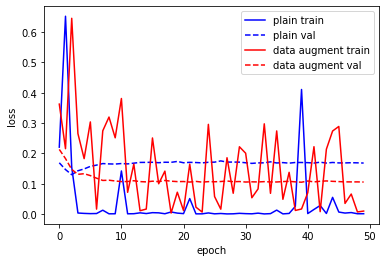

In [58]:
plt.plot(range(50), train_loss, label='plain train', color='blue')
plt.plot(range(50), val_loss, label='plain val', linestyle='--', color='blue')
plt.plot(range(50), train_loss_2, label='data augment train', color='red')
plt.plot(range(50), val_loss_2, label='data augment val', linestyle='--', color='red')
plt.legend()
plt.xlabel('epoch')
plt.ylabel('loss')
plt.savefig('resnet18_loss.jpg')
plt.show()

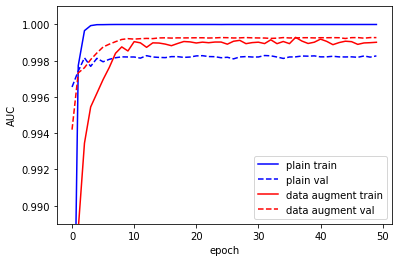

In [62]:
plt.plot(range(50), train_auc, label='plain train', color='blue')
plt.plot(range(50), val_auc, label='plain val', linestyle='--', color='blue')
plt.plot(range(50), train_auc_2, label='data augment train', color='red')
plt.plot(range(50), val_auc_2, label='data augment val', linestyle='--', color='red')
plt.legend()
plt.xlabel('epoch')
plt.ylabel('AUC')
plt.ylim([0.989, 1.001])
plt.savefig('resnet18_auc.jpg')
plt.show()

ROC curve
---------------------------

In [9]:
# resnet18_without_augment_sgd_lr_001_momentum_9_stepsize_7_gamma_1_epoch_50_batch_size_32
aucs, losses = np.zeros(10), np.zeros(10)
fpr_991, fpr_993, fpr_995, fpr_997, fpr_1 = np.zeros(10), np.zeros(10), np.zeros(10), np.zeros(10), np.zeros(10)
for i in range(10):
    model.load_state_dict(best_model_wts[i])
    y_true, y_score, image_id, auc, loss = test(model)
    aucs[i] = auc
    losses[i] = loss
    fpr, tpr, thr = metrics.roc_curve(y_true!=4, 1-y_score[:,4])
    fpr_991[i] = fpr[tpr>=0.991][0]
    fpr_993[i] = fpr[tpr>=0.993][0]
    fpr_995[i] = fpr[tpr>=0.995][0]
    fpr_997[i] = fpr[tpr>=0.997][0]
    fpr_1[i] = fpr[tpr>=1][0]
print('FPR mean')
print(np.mean(fpr_991), np.mean(fpr_993), np.mean(fpr_995), np.mean(fpr_997), np.mean(fpr_1))
print('FPR std')
print(np.std(fpr_991), np.std(fpr_993), np.std(fpr_995), np.std(fpr_997), np.std(fpr_1))
print('AUC and loss mean')
print(np.mean(aucs), np.mean(losses))
print('AUC and loss std')
print(np.std(aucs), np.std(losses))

Test set - Average loss: 0.1683, AUC: 99.6272%
Test set - Average loss: 0.1703, AUC: 99.6262%
Test set - Average loss: 0.1705, AUC: 99.6347%
Test set - Average loss: 0.1679, AUC: 99.6324%
Test set - Average loss: 0.1703, AUC: 99.6277%
Test set - Average loss: 0.1706, AUC: 99.6226%
Test set - Average loss: 0.1697, AUC: 99.6271%
Test set - Average loss: 0.1719, AUC: 99.6161%
Test set - Average loss: 0.1706, AUC: 99.6288%
Test set - Average loss: 0.1700, AUC: 99.6280%
FPR mean
0.049804751295922885 0.1639423249693101 0.2593473805518949 0.2790893121842516 0.42479011403583866
FPR std
0.0021911042453023064 0.01691860811997249 0.012986514015096559 0.013118233708332124 0.01304823710951121
AUC and loss mean
0.9962708528076926 0.170025039335455
AUC and loss std
4.8093105798510085e-05 0.0011001871596010003


In [9]:
# 10-crop resnet18_without_augment_sgd_lr_001_momentum_9_stepsize_7_gamma_1_epoch_50_batch_size_32
# worse than simple center crop
aucs, losses = np.zeros(10), np.zeros(10)
fpr_991, fpr_993, fpr_995, fpr_997, fpr_1 = np.zeros(10), np.zeros(10), np.zeros(10), np.zeros(10), np.zeros(10)

for i in range(10):
    model.load_state_dict(best_model_wts[i])
    y_true, y_score, image_id, auc, loss = test_ten_crop(model)
    aucs[i] = auc
    losses[i] = loss
    fpr, tpr, thr = metrics.roc_curve(y_true!=4, 1-y_score[:,4])
    fpr_991[i] = fpr[tpr>=0.991][0]
    fpr_993[i] = fpr[tpr>=0.993][0]
    fpr_995[i] = fpr[tpr>=0.995][0]
    fpr_997[i] = fpr[tpr>=0.997][0]
    fpr_1[i] = fpr[tpr>=1][0]
print('FPR mean')
print(np.mean(fpr_991), np.mean(fpr_993), np.mean(fpr_995), np.mean(fpr_997), np.mean(fpr_1))
print('FPR std')
print(np.std(fpr_991), np.std(fpr_993), np.std(fpr_995), np.std(fpr_997), np.std(fpr_1))
print('AUC and loss mean')
print(np.mean(aucs), np.mean(losses))
print('AUC and loss std')
print(np.std(aucs), np.std(losses))

Test set - Average loss: 0.1705, AUC: 99.5469%
Test set - Average loss: 0.1814, AUC: 99.5415%
Test set - Average loss: 0.1814, AUC: 99.5429%
Test set - Average loss: 0.1799, AUC: 99.5483%
Test set - Average loss: 0.1817, AUC: 99.5339%
Test set - Average loss: 0.1903, AUC: 99.5357%
Test set - Average loss: 0.1703, AUC: 99.5447%
Test set - Average loss: 0.1664, AUC: 99.5463%
Test set - Average loss: 0.1822, AUC: 99.5504%
Test set - Average loss: 0.1877, AUC: 99.5392%
FPR mean
0.06096145947366853 0.0745177594211442 0.20015227963782092 0.2249189444819859 0.8717204810053115
FPR std
0.006069059868062424 0.004119107160046117 0.01452990530298635 0.006154760973376266 0.010465826483469595
AUC and loss mean
0.995429748489439 0.17917228697174212
AUC and loss std
5.147413320615615e-05 0.007347201948853362


In [33]:
# 10-crop resnet18_augment_sgd_lr_001_momentum_9_stepsize_7_gamma_1_epoch_50_batch_size_32
# significantly decrease FPR when TPR is high, but underperform when TPR is 99.1%, 99.3
aucs, losses = np.zeros(10), np.zeros(10)
fpr_991, fpr_993, fpr_995, fpr_997, fpr_1 = np.zeros(10), np.zeros(10), np.zeros(10), np.zeros(10), np.zeros(10)
for i in range(10):
    y_true, y_score, image_id, auc, loss = test_ten_crop(model)
    aucs[i] = auc
    losses[i] = loss
    fpr, tpr, thr = metrics.roc_curve(y_true!=4, 1-y_score[:,4])
    fpr_991[i] = fpr[tpr>=0.991][0]
    fpr_993[i] = fpr[tpr>=0.993][0]
    fpr_995[i] = fpr[tpr>=0.995][0]
    fpr_997[i] = fpr[tpr>=0.997][0]
    fpr_1[i] = fpr[tpr>=1][0]
print('FPR mean')
print(np.mean(fpr_991), np.mean(fpr_993), np.mean(fpr_995), np.mean(fpr_997), np.mean(fpr_1))
print('FPR std')
print(np.std(fpr_991), np.std(fpr_993), np.std(fpr_995), np.std(fpr_997), np.std(fpr_1))
print('AUC and loss mean')
print(np.mean(aucs), np.mean(losses))
print('AUC and loss std')
print(np.std(aucs), np.std(losses))

Test set - Average loss: 0.1233, AUC: 99.7075%
Test set - Average loss: 0.1233, AUC: 99.7124%
Test set - Average loss: 0.1233, AUC: 99.6875%
Test set - Average loss: 0.1233, AUC: 99.7086%
Test set - Average loss: 0.1233, AUC: 99.6981%
Test set - Average loss: 0.1233, AUC: 99.7098%
Test set - Average loss: 0.1233, AUC: 99.7090%
Test set - Average loss: 0.1233, AUC: 99.7086%
Test set - Average loss: 0.1233, AUC: 99.6958%
Test set - Average loss: 0.1233, AUC: 99.7112%
FPR std
0.07206075531965514 0.08333145621631488 0.11942923087571225 0.13838933196850672 0.2461882818849659
FPR std
0.003146134899515045 0.008002340645811025 0.00043409836541355516 0.00043892416233948093 0.0006643483038559704
AUC and loss mean
0.9970483763192801 0.12330722325464452
AUC and loss std
7.759311735254028e-05 9.273046109358963e-10


In [13]:
# resnet18_augment_sgd_lr_001_momentum_9_stepsize_7_gamma_1_epoch_50_batch_size_32
y_true, y_score, image_id, auc, loss = test(model)
fpr, tpr, thr = metrics.roc_curve(y_true!=4, 1-y_score[:,4])
fpr_991 = fpr[tpr>=0.991][0]
fpr_993 = fpr[tpr>=0.993][0]
fpr_995 = fpr[tpr>=0.995][0]
fpr_997 = fpr[tpr>=0.997][0]
fpr_1 = fpr[tpr>=1][0]
print(fpr_991)
print(fpr_993)
print(fpr_995)
print(fpr_997)
print(fpr_1)

Test set - Average loss: 0.1149, AUC: 99.7004%
0.0244140625
0.044596354166666664
0.14095052083333334
0.2734375
0.7578125


In [21]:
y_true, y_score, image_id, auc, loss = test(model)

Test set - Average loss: 0.1683, AUC: 99.6304%


In [22]:
image_id_test = np.array(list(sum(image_id, ()))+[i for i in image_id[-1]])

In [23]:
image_id_test.shape

(3852,)

In [26]:
image_id_dict = {}
for i in range(10):
    idx = np.where(y_true==i)[0]
    sort = torch.argsort(y_score[idx,i],descending=True)
    if len(idx)<=60:
        image_id_dict[class_names[i]+'_id'] = image_id_test[idx[sort]]
        image_id_dict[class_names[i]+'_score'] = y_score[idx[sort]]
        print(i, class_names[i], len(sort))
    else:
        high_idx = idx[sort][:30]
        low_idx = idx[sort][-30:]
        image_id_dict[class_names[i]+'_high_id'] = image_id_test[high_idx]
        image_id_dict[class_names[i]+'_low_id'] = image_id_test[low_idx]
        image_id_dict[class_names[i]+'_high_score'] = y_score[high_idx]
        image_id_dict[class_names[i]+'_low_score'] = y_score[low_idx]
idx = np.where(y_true!=4)[0]
sort = torch.argsort(y_score[idx,4], descending=True)
bad_low_idx = idx[sort][:30]
image_id_dict['bad_low_id'] = image_id_test[bad_low_idx]
image_id_dict['bad_low_score'] = y_score[bad_low_idx]
image_id_dict['bad_low_class'] = y_true[bad_low_idx]

1 device_flip 16
2 empty_pocket 20
5 lead_defect 25
7 marking_defect 18
8 pocket_damage 1


In [27]:
state_dict['test_result'] = image_id_dict

In [46]:
torch.save(state_dict, 'resnet18_without_augment_sgd_lr_001_momentum_9_stepsize_7_gamma_1_epoch_50_batch_size_32.pt')

CAM
------

In [25]:
def im(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0)) # The input is CXHXW, the output is HXWXC
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    return inp
            
def plot_cam(model, image_path):
    
    img = Image.open(image_path).convert('RGB')# note that this was a grayscale image
    img_tensor = data_transforms['val'](img).view(1,3,224,224).to(device)
    weights = model.fc.weight # size[10,512]
    resnet_conv = nn.Sequential(*list(model.children())[:-2])
    
    # define the operation of upsampling to the image size
    m = nn.Upsample(size=(224,224), mode='bilinear') 
    
    m = m.to(device) 
    img_tensor = img_tensor.to(device)
        
    last_conv_output = resnet_conv(img_tensor)
    
    act_maps = torch.matmul(last_conv_output.permute(0,2,3,1), weights.T).permute(0,3,1,2)
    out = m(act_maps)

    return torch.squeeze(out)

/home/kaiyihuang/.conda/envs/tensorflow2_pytorch/lib/python3.7/site-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


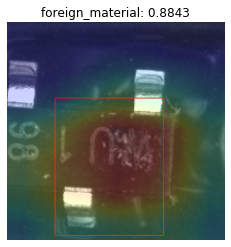

In [28]:
# trained without data augmentation
# pocket damge

defect = 8
    
image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id']+'.bmp')
img = Image.open(image_path).convert('RGB')
x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_id'])][['x_1', 'y_1', 'x_2', 'y_2']]
img = Image.open(image_path).convert('RGB')
draw = ImageDraw.Draw(img)
draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
img = data_transforms['test'](img)
out = plot_cam(model, image_path)
plt.imshow(im(img))
plt.imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
plt.title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'])], torch.max(image_id_dict[class_names[defect]+'_score'])))
plt.axis('off')
plt.show()

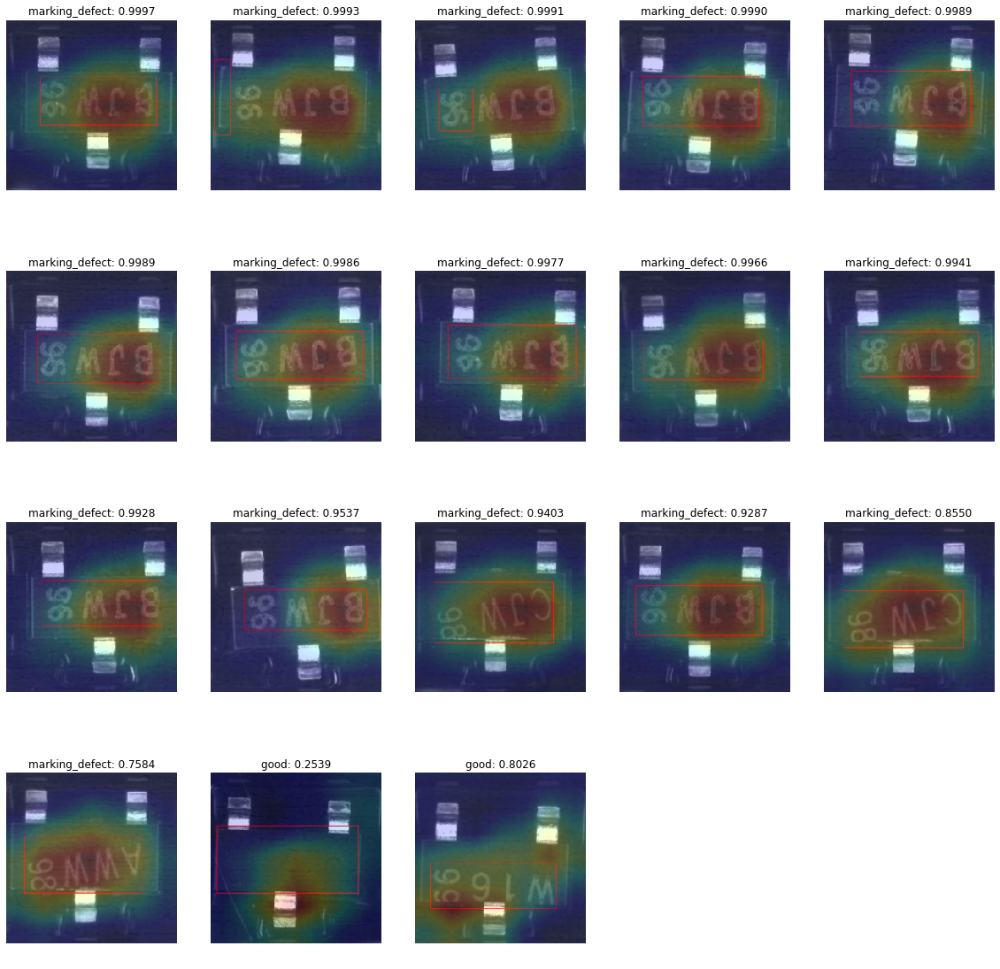

In [29]:
# marking defect

defect = 7

fig, axs = plt.subplots(4, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(18):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])], torch.max(image_id_dict[class_names[defect]+'_score'][i])))
    axs[i].axis('off')
    
for i in range(18,20):
    axs[i].axis('off')

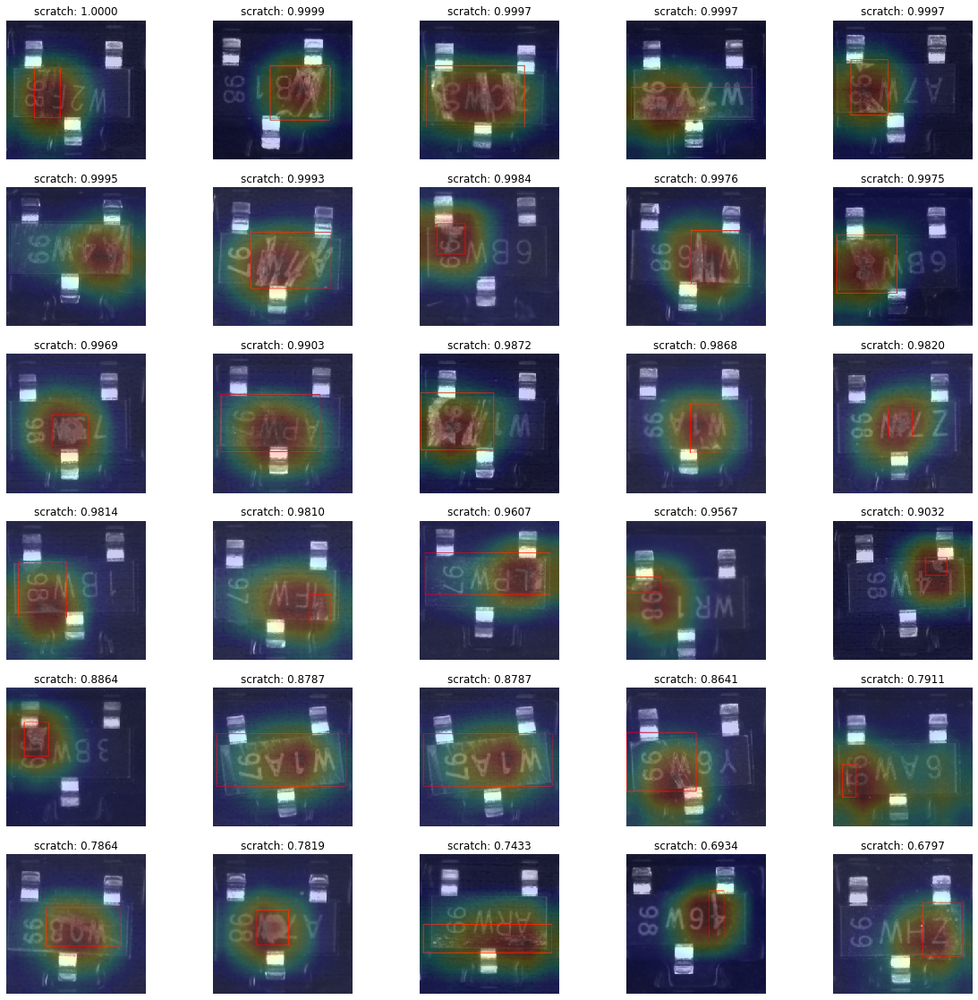

In [30]:
# scratch high
defect = 9

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

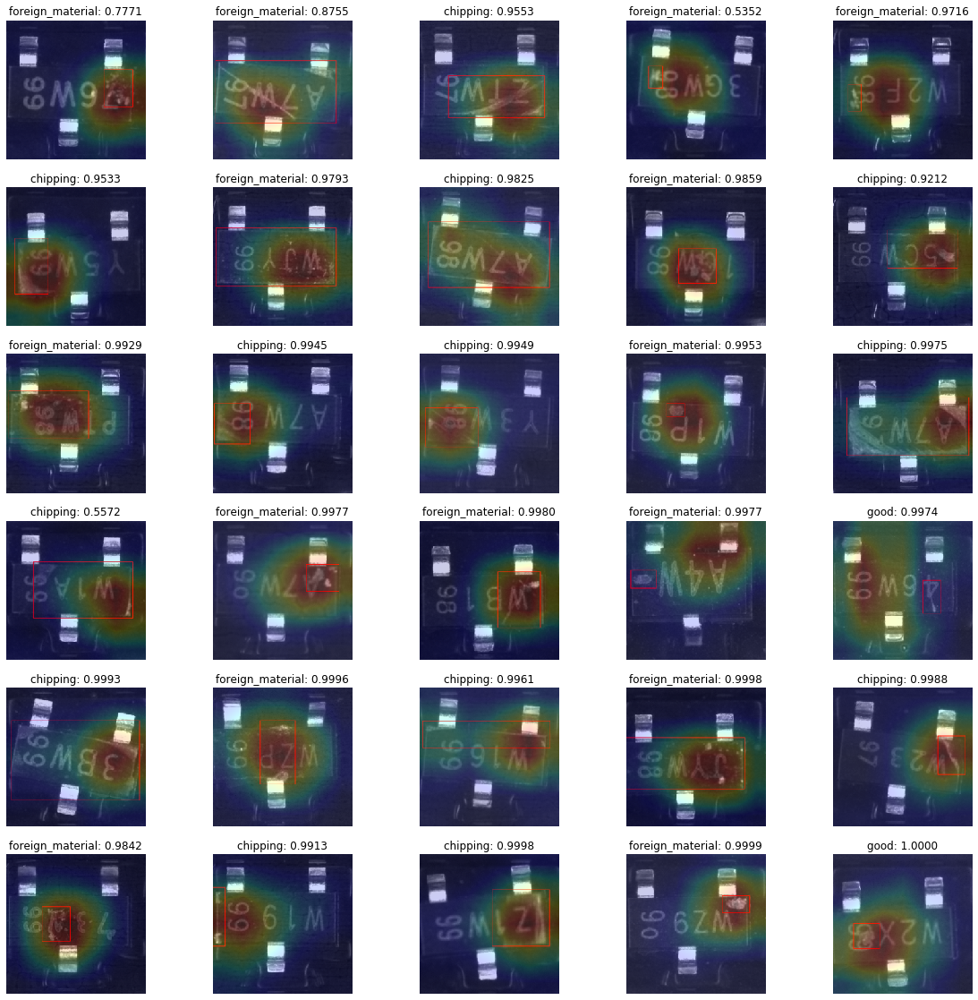

In [31]:
# scratch low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

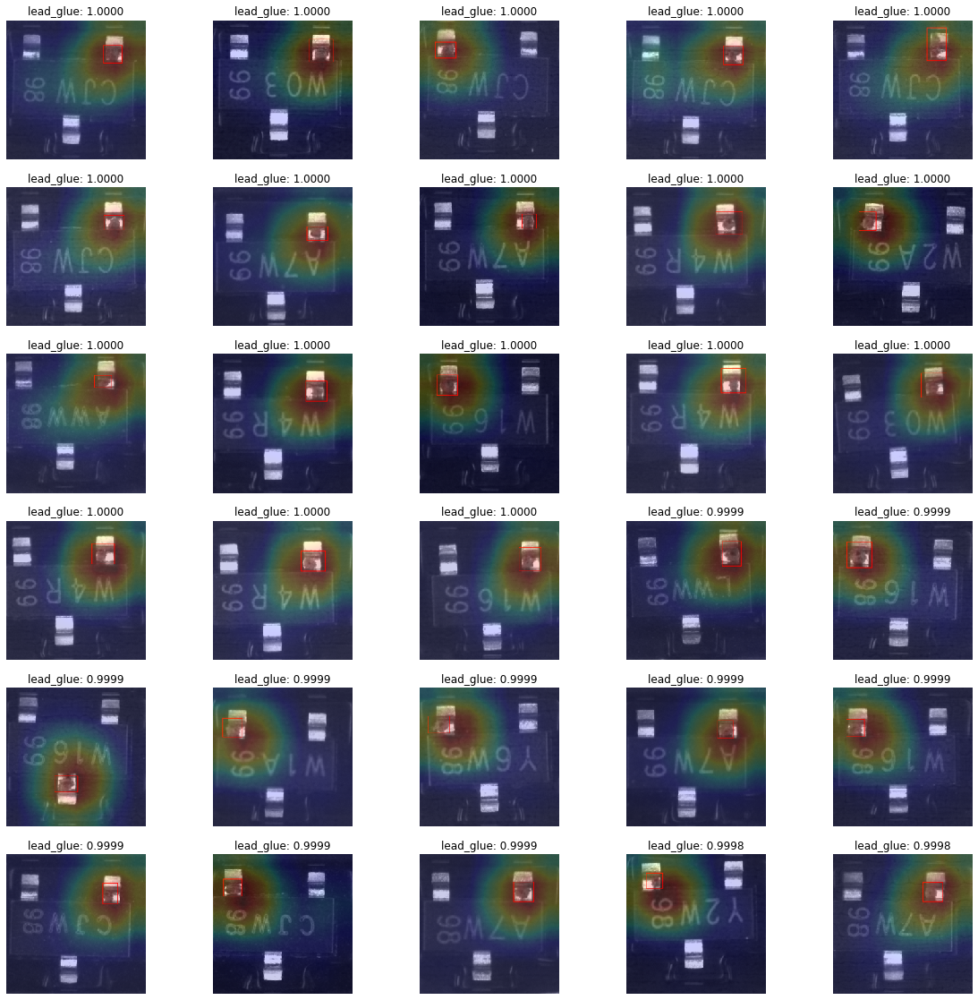

In [32]:
# lead glue high
defect = 6

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

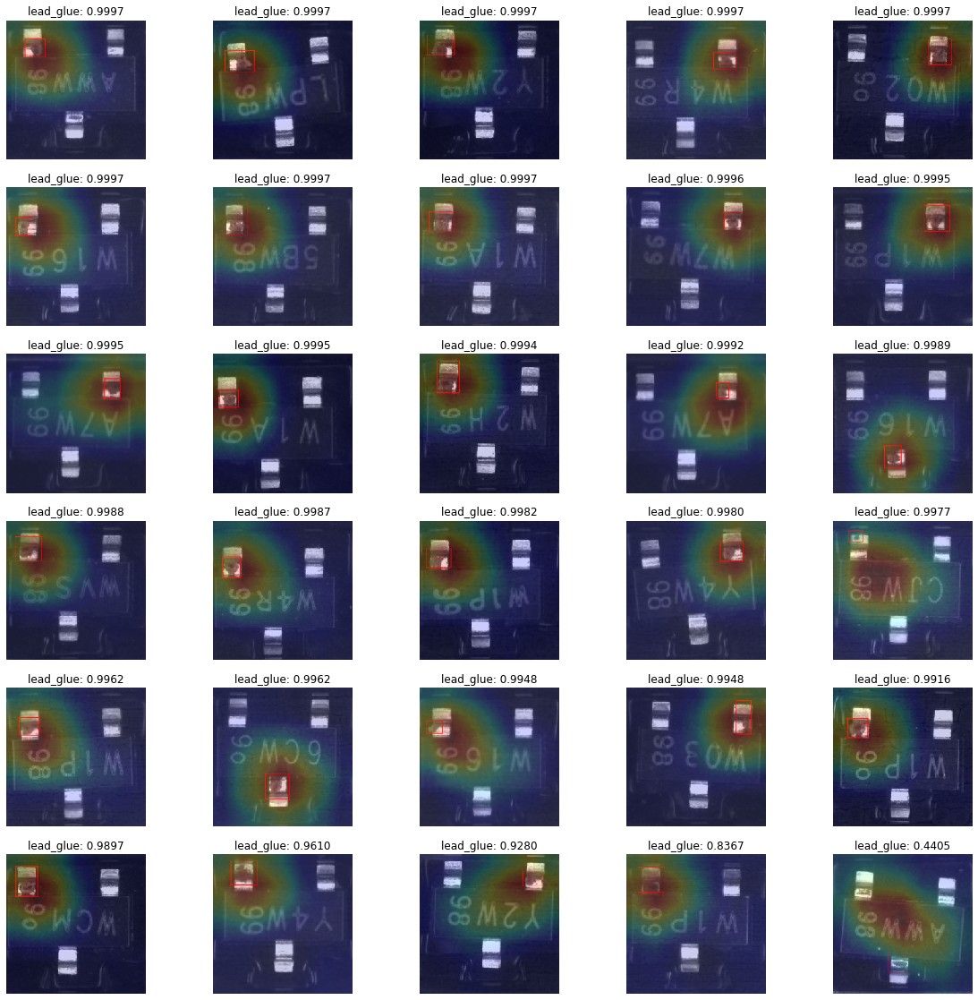

In [33]:
# lead glue low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

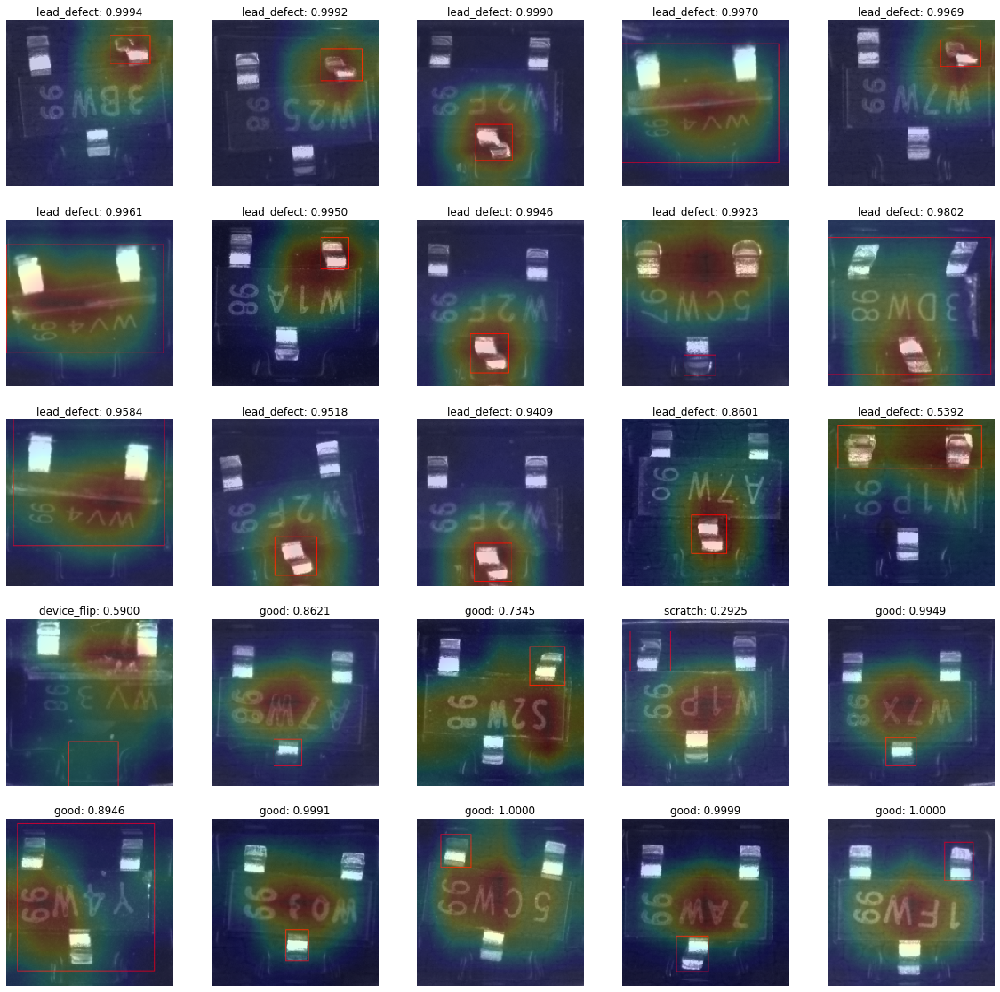

In [34]:
# lead defect

defect = 5

fig, axs = plt.subplots(5, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(25):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])], torch.max(image_id_dict[class_names[defect]+'_score'][i])))
    axs[i].axis('off')

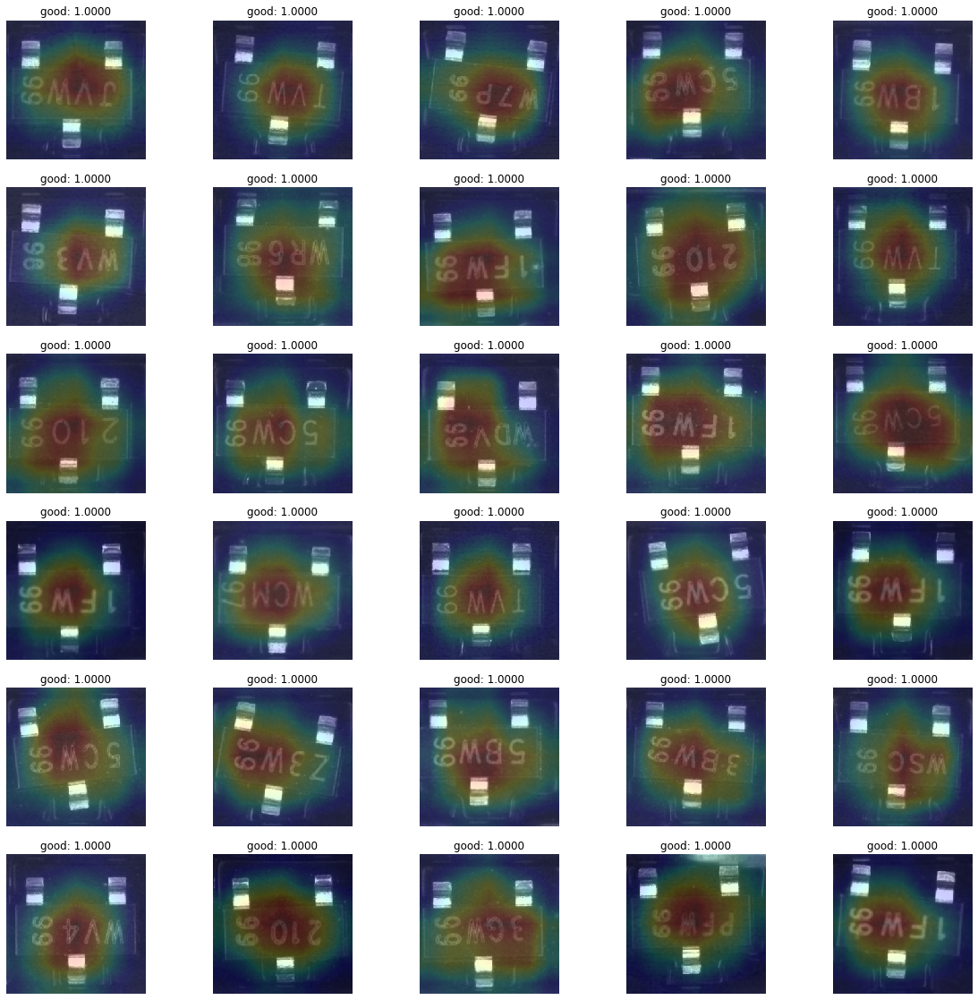

In [35]:
# good high
defect = 4

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191003_SOT23_PassImage', image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

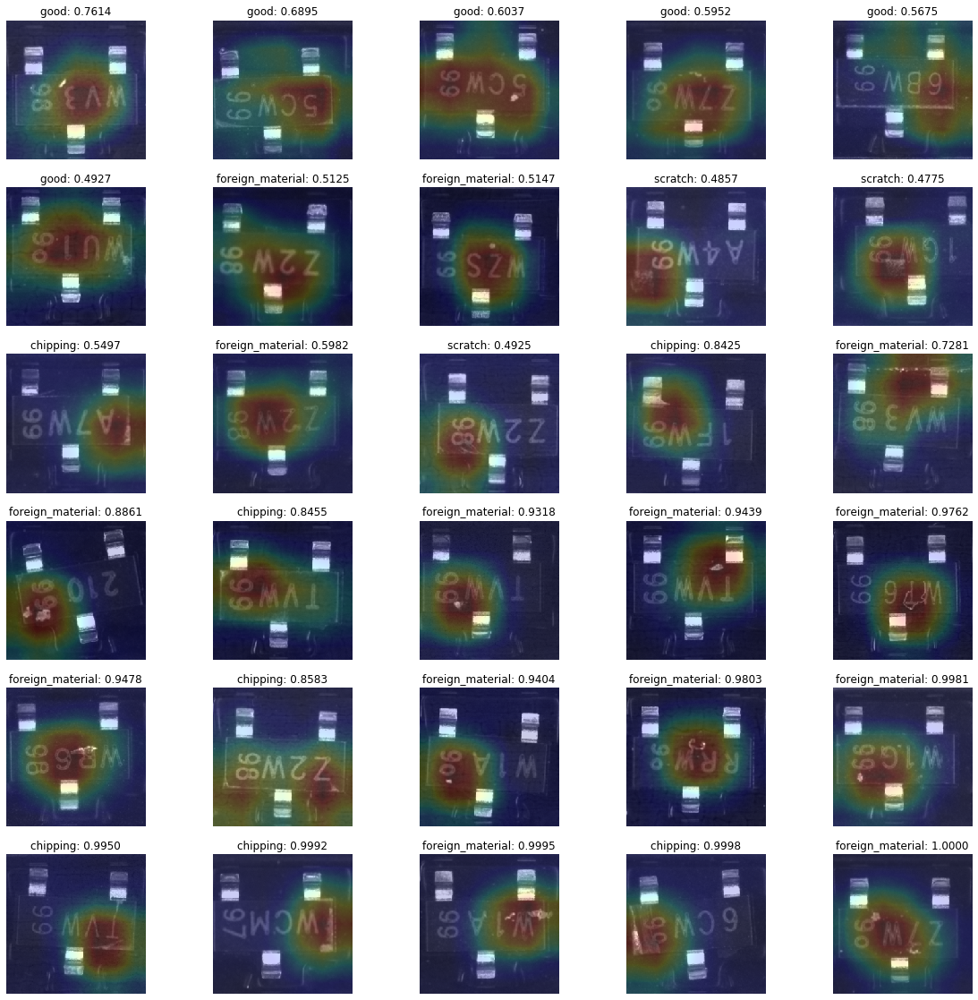

In [36]:
# good low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191003_SOT23_PassImage', image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

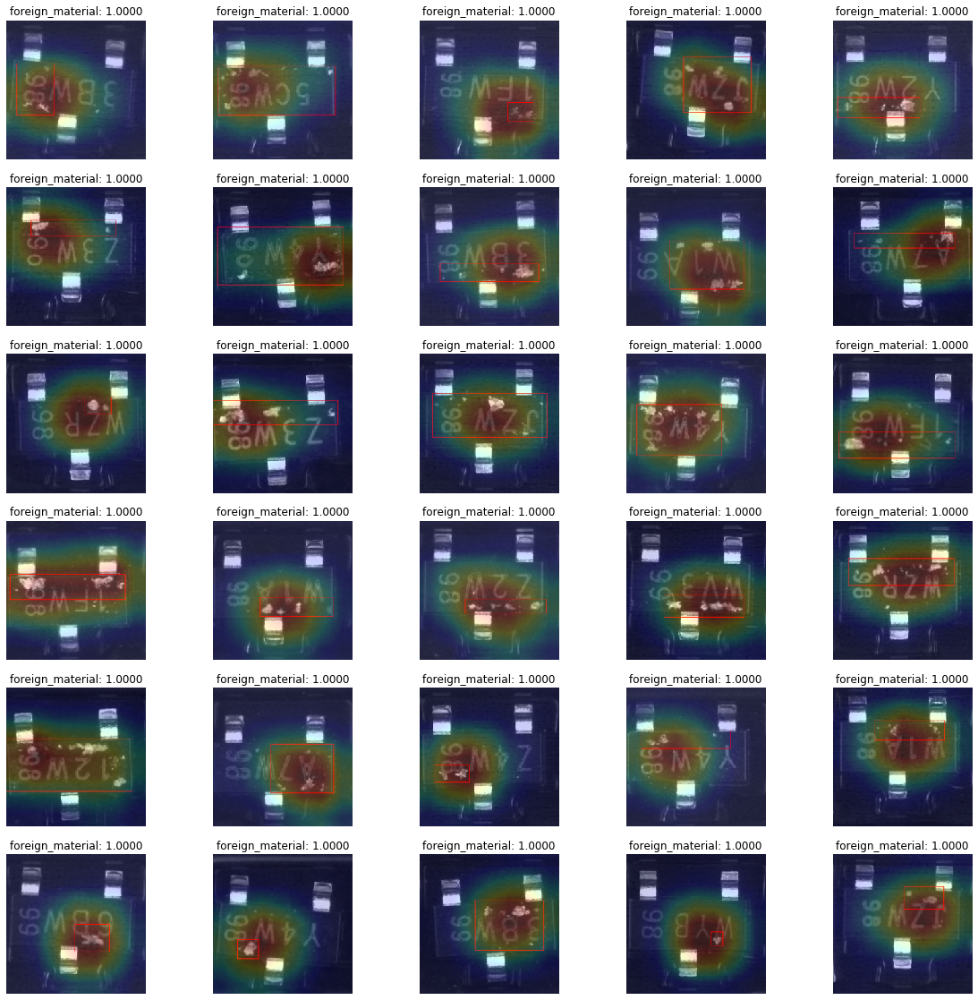

In [37]:
# foreign material high
defect = 3

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

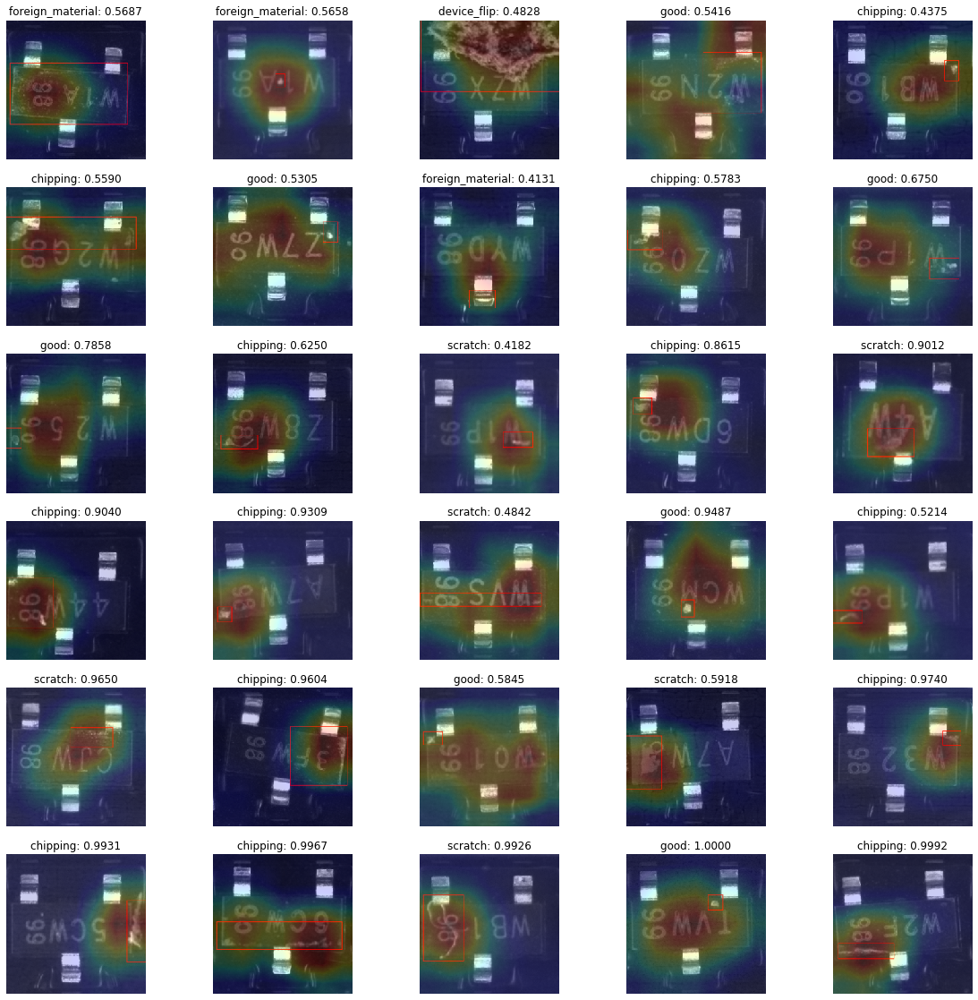

In [38]:
# foreign material low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

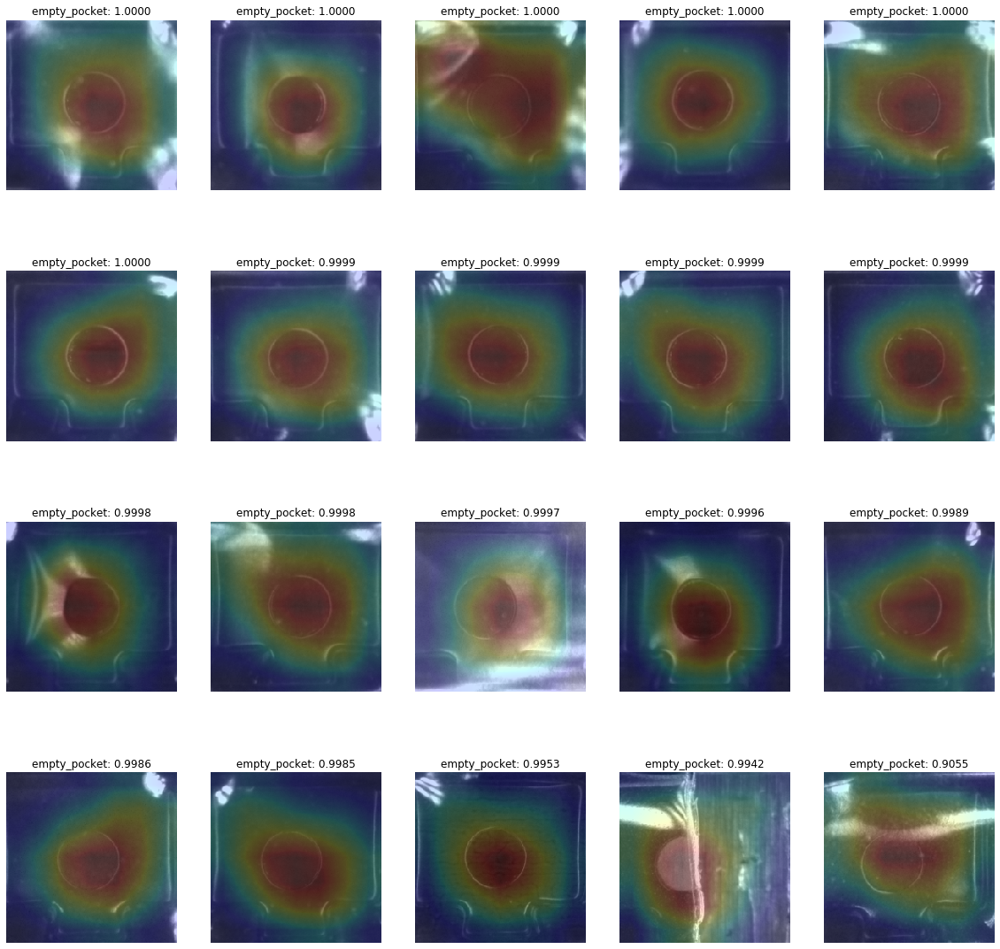

In [39]:
# empty pocket
defect = 2

fig, axs = plt.subplots(4, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(20):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])], torch.max(image_id_dict[class_names[defect]+'_score'][i])))
    axs[i].axis('off')

(0.0, 1.0, 0.0, 1.0)

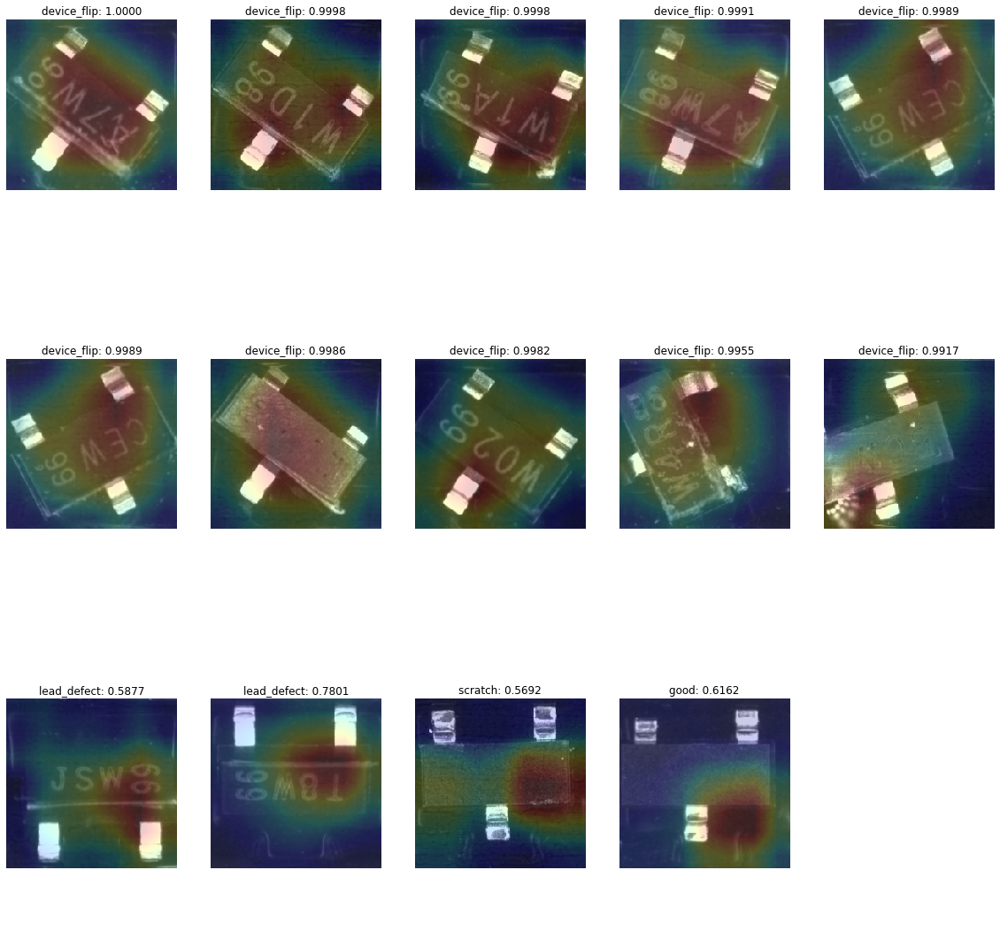

In [40]:
# device flip
defect = 1

fig, axs = plt.subplots(3, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(14):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])], torch.max(image_id_dict[class_names[defect]+'_score'][i])))
    axs[i].axis('off')
axs[14].axis('off')

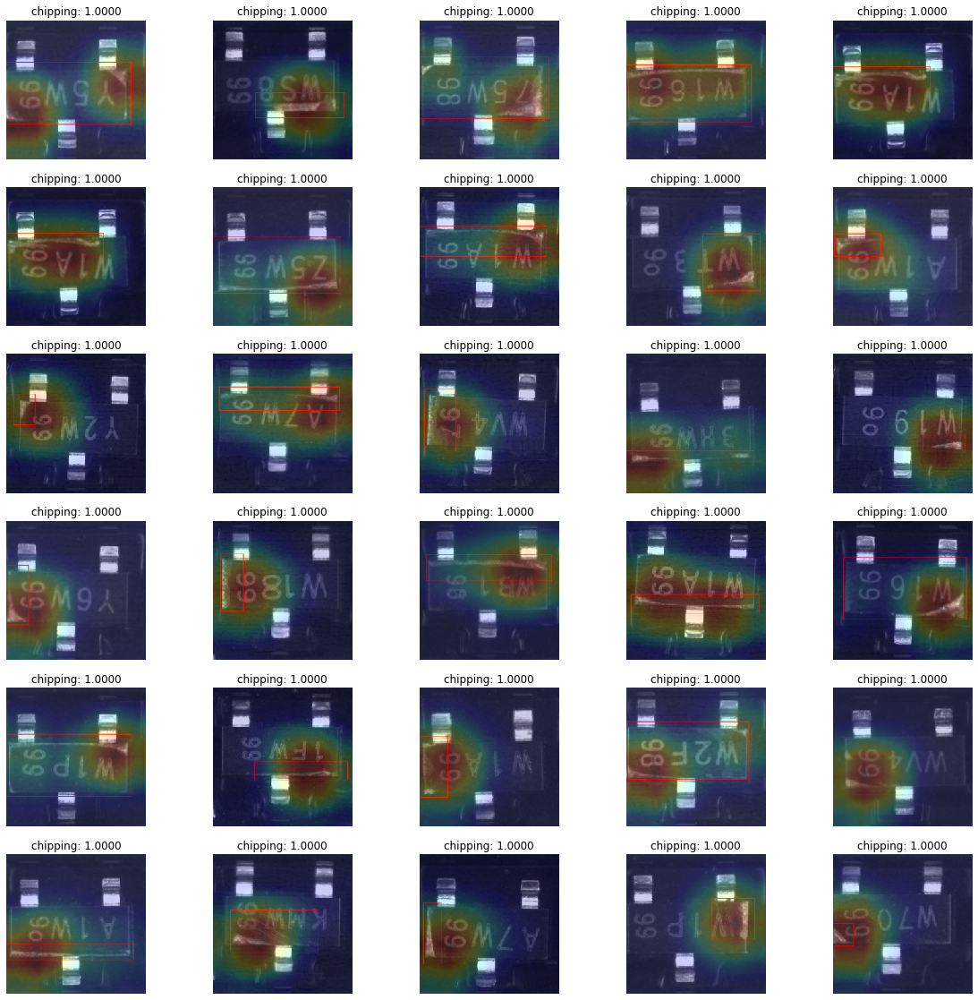

In [41]:
# chipping high
defect = 0

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

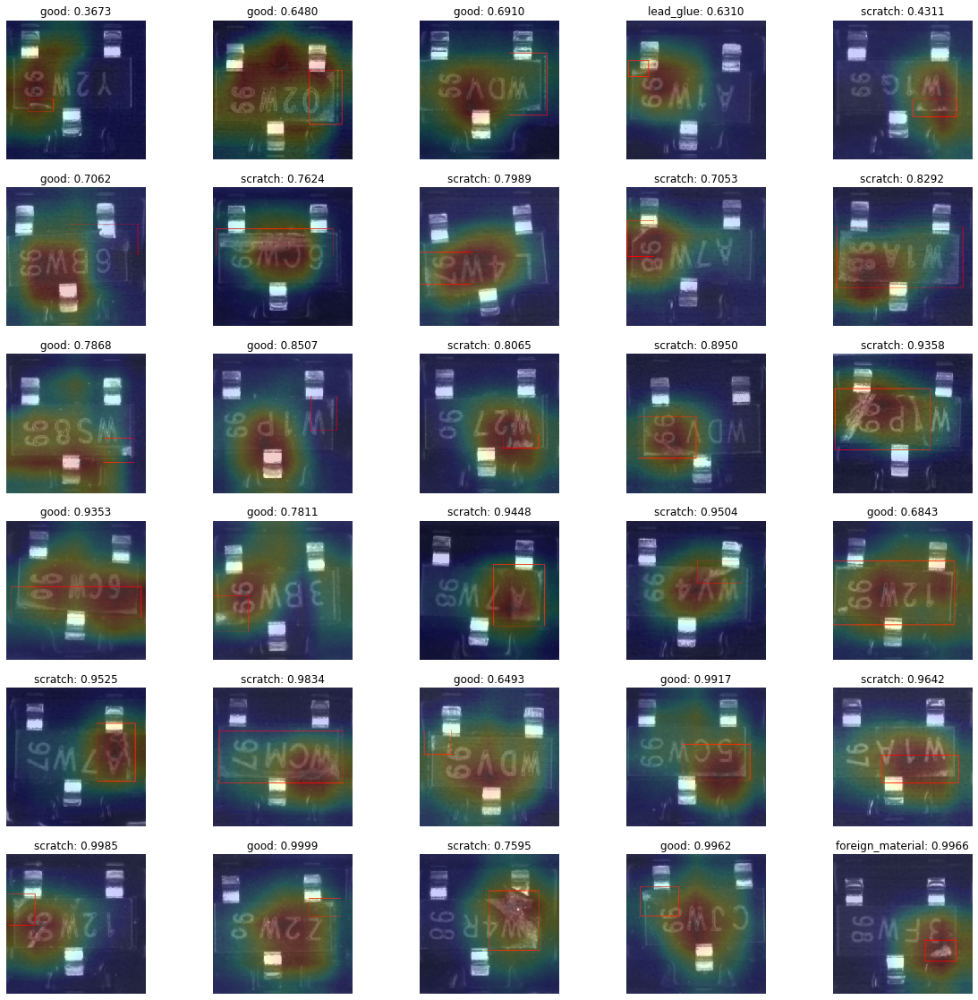

In [42]:
# chipping low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

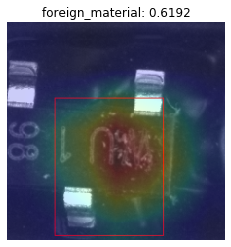

In [104]:
# trained with data augmentation
# pocket damge

defect = 8
    
image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id']+'.bmp')
img = Image.open(image_path).convert('RGB')
x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_id'])][['x_1', 'y_1', 'x_2', 'y_2']]
img = Image.open(image_path).convert('RGB')
draw = ImageDraw.Draw(img)
draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
img = data_transforms['test'](img)
out = plot_cam(model, image_path)
plt.imshow(im(img))
plt.imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
plt.title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'])], torch.max(image_id_dict[class_names[defect]+'_score'])))
plt.axis('off')
plt.show()

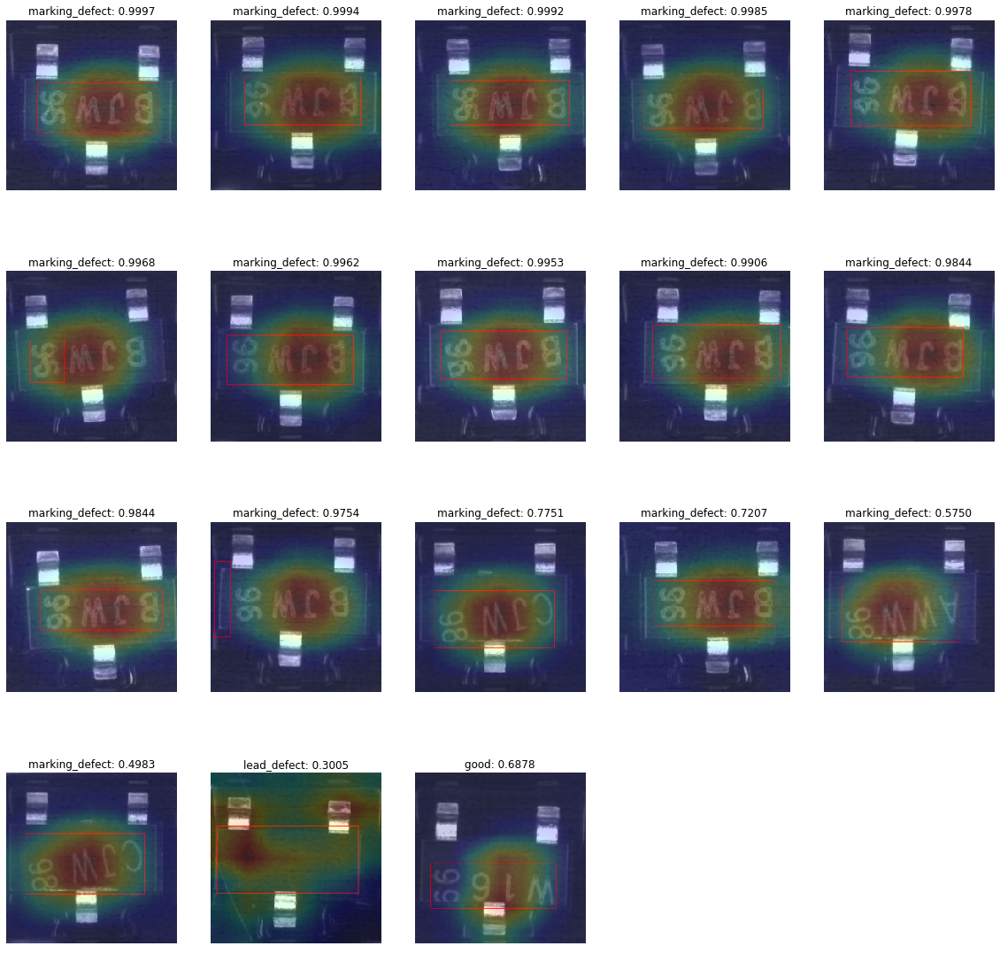

In [92]:
# marking defect

defect = 7

fig, axs = plt.subplots(4, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(18):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])], torch.max(image_id_dict[class_names[defect]+'_score'][i])))
    axs[i].axis('off')
    
for i in range(18,20):
    axs[i].axis('off')

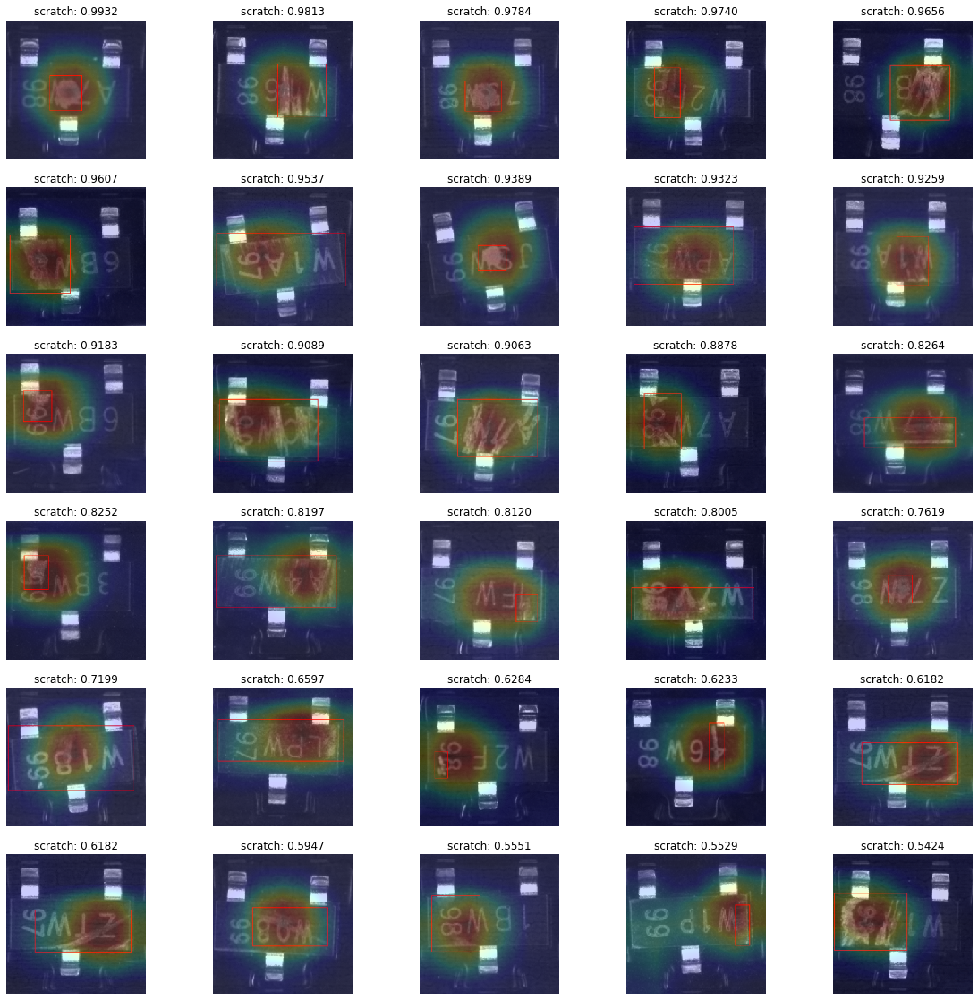

In [86]:
# scratch high
defect = 9

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

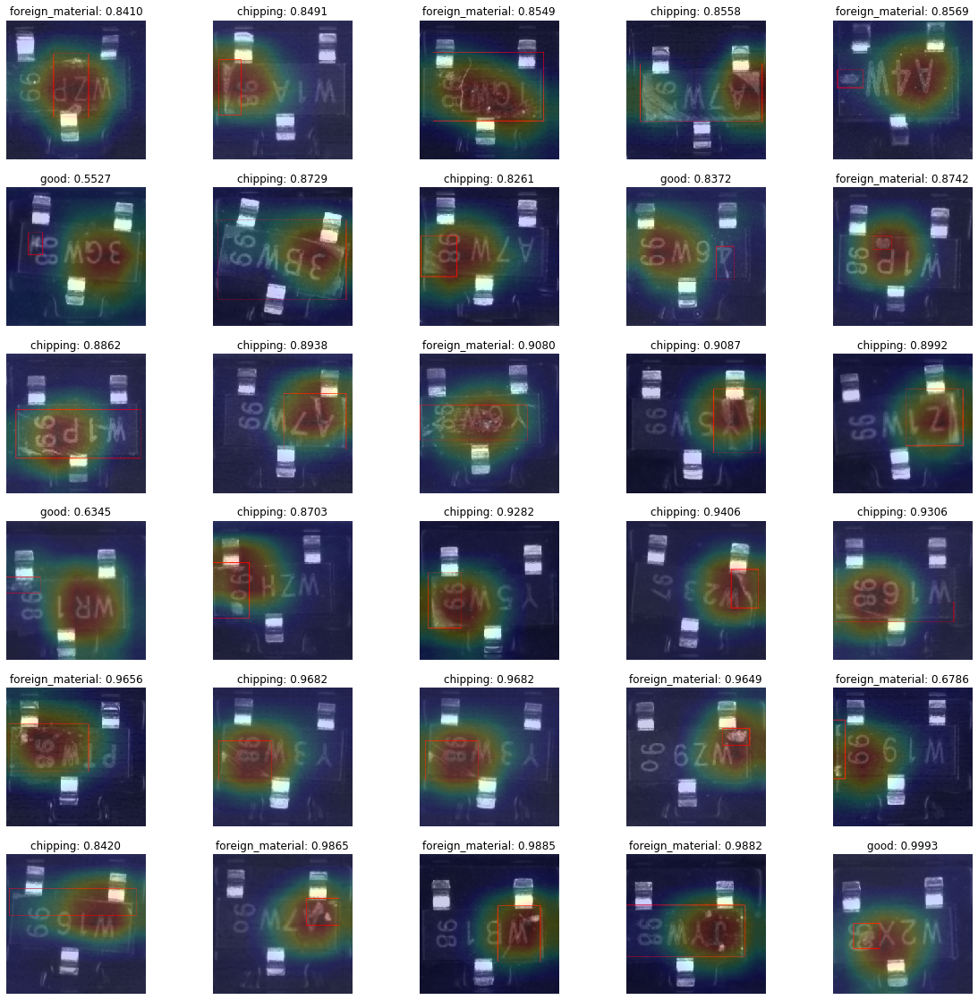

In [87]:
# scratch low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

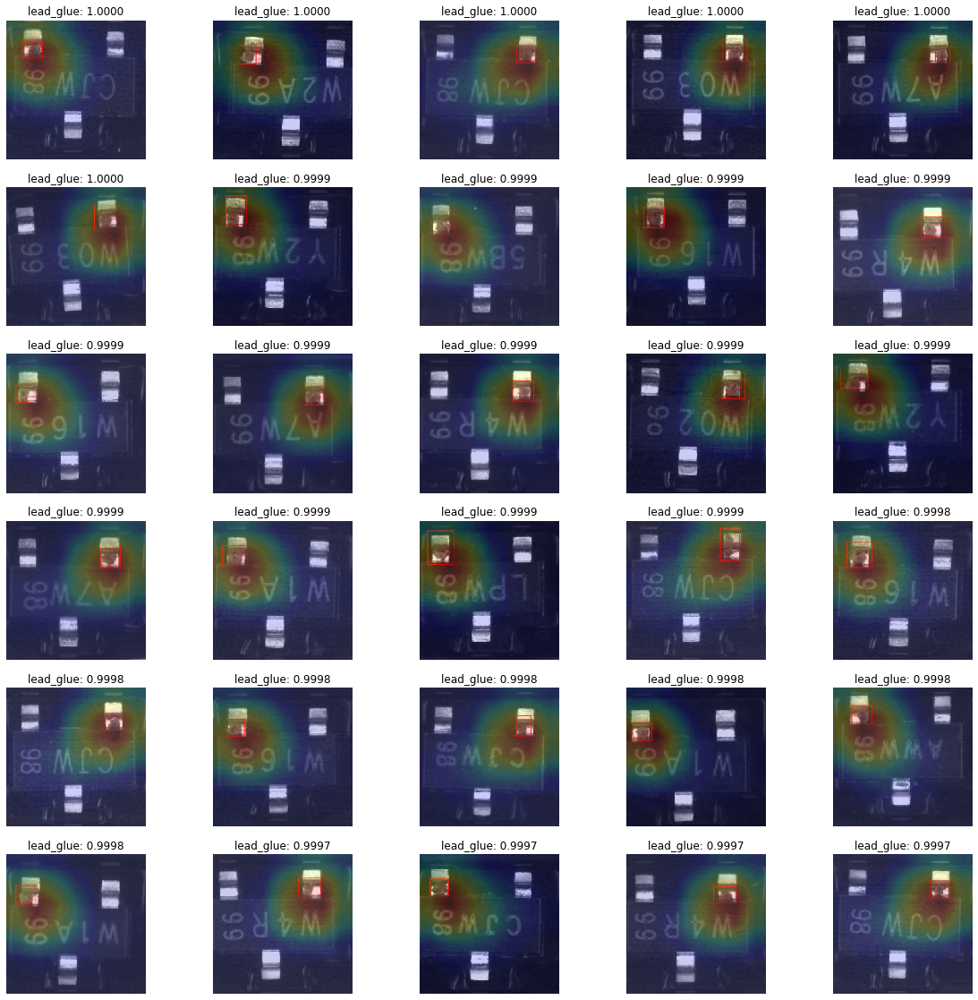

In [84]:
# lead glue high
defect = 6

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

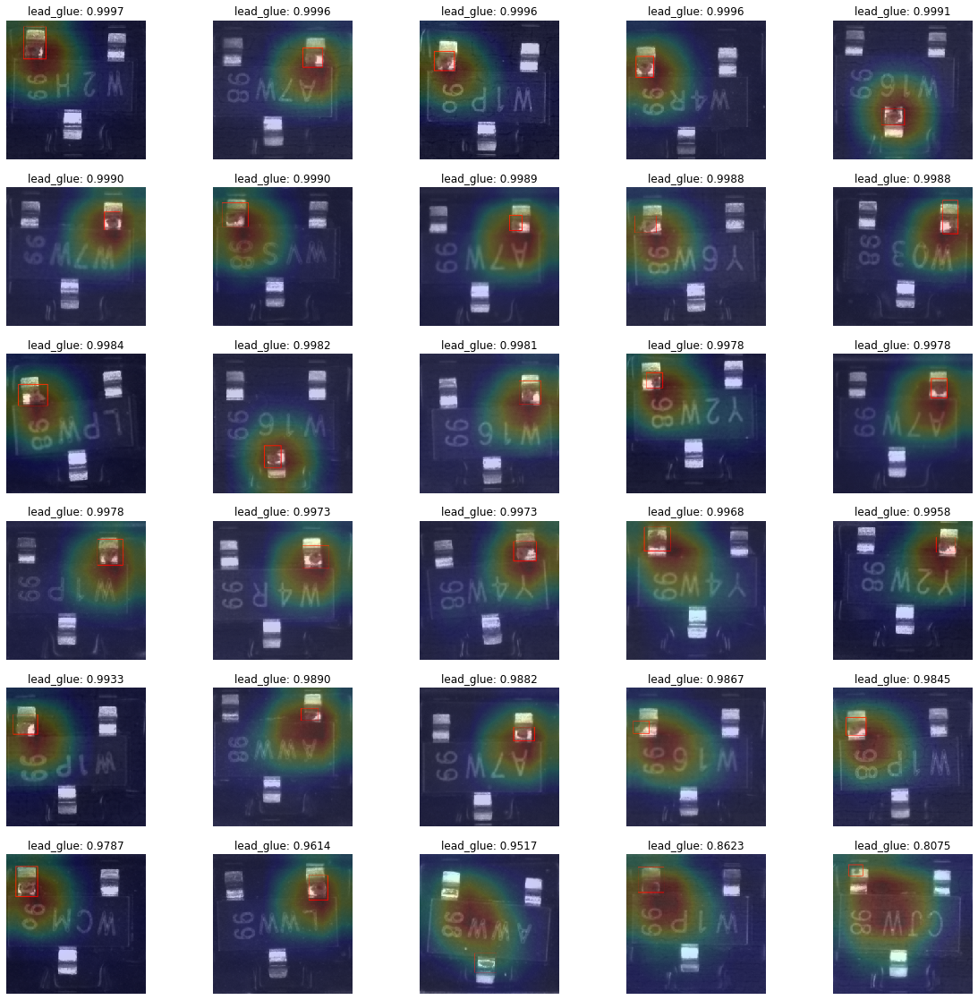

In [85]:
# lead glue low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

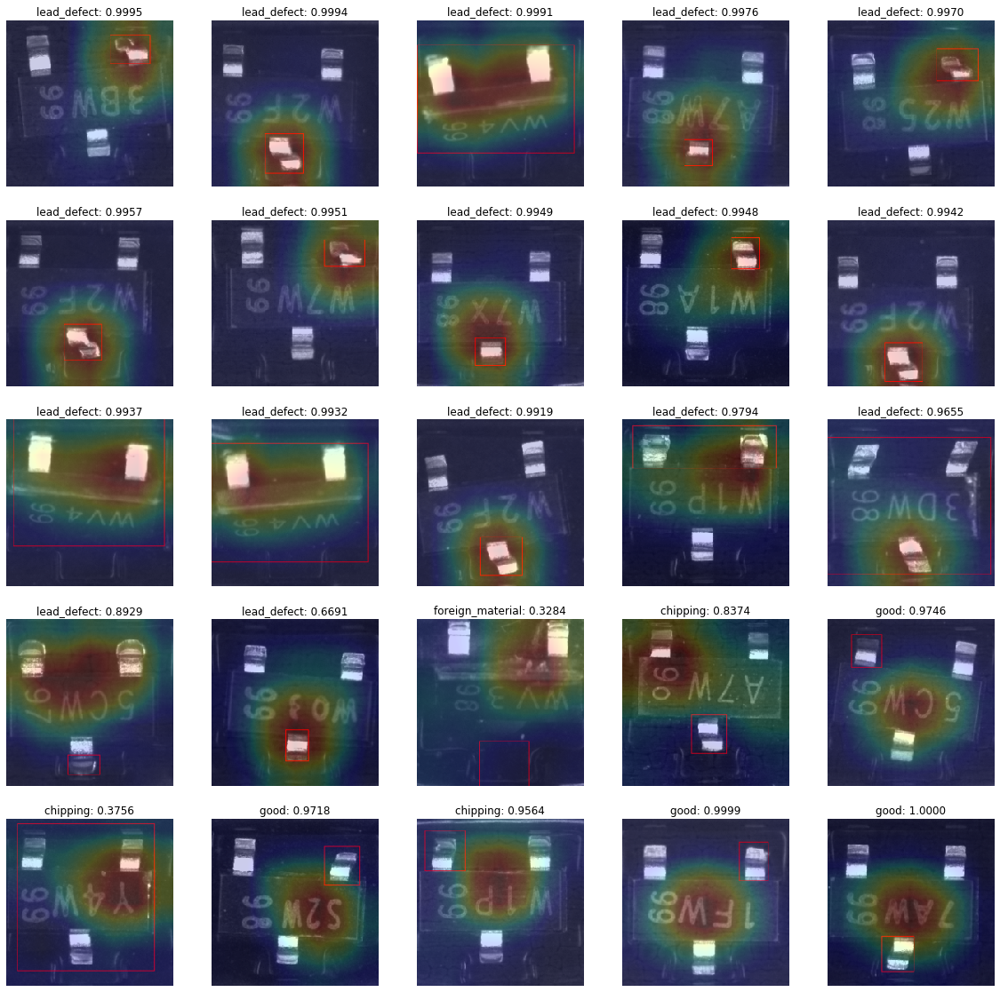

In [88]:
# lead defect

defect = 5

fig, axs = plt.subplots(5, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(25):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])], torch.max(image_id_dict[class_names[defect]+'_score'][i])))
    axs[i].axis('off')

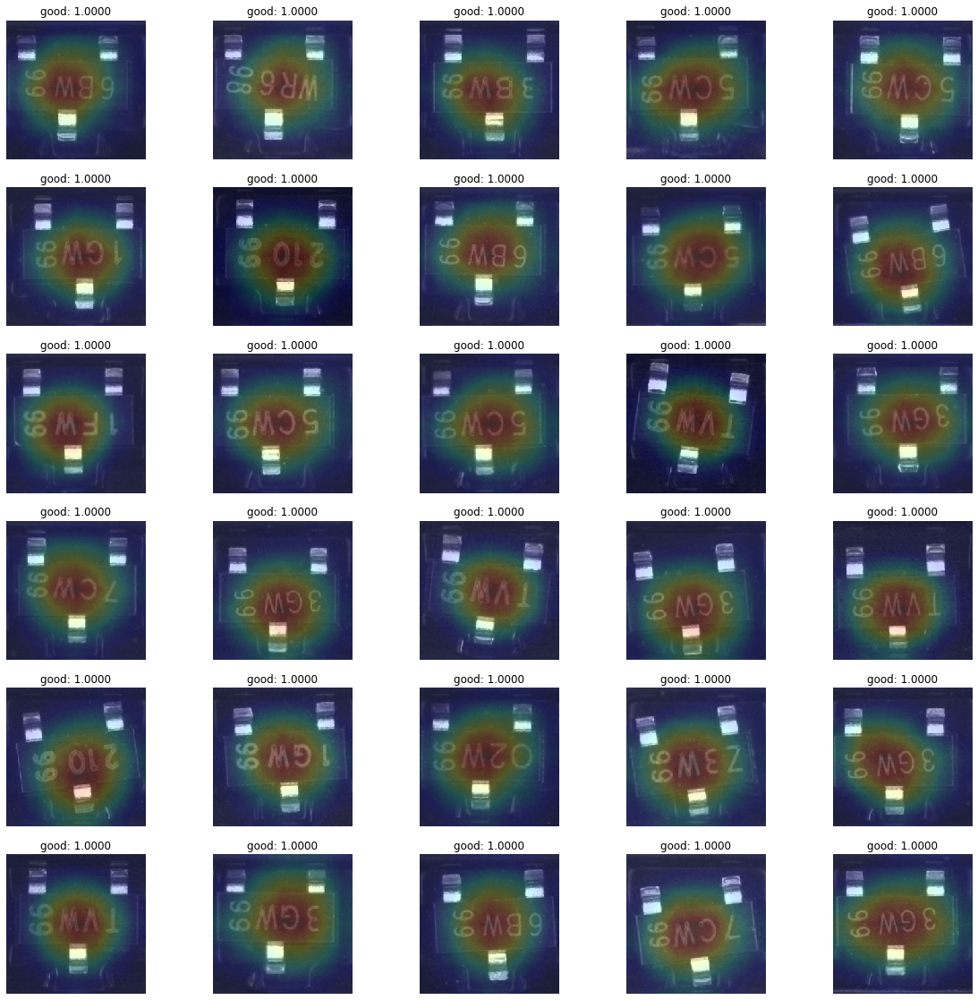

In [77]:
# good high
defect = 4

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191003_SOT23_PassImage', image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

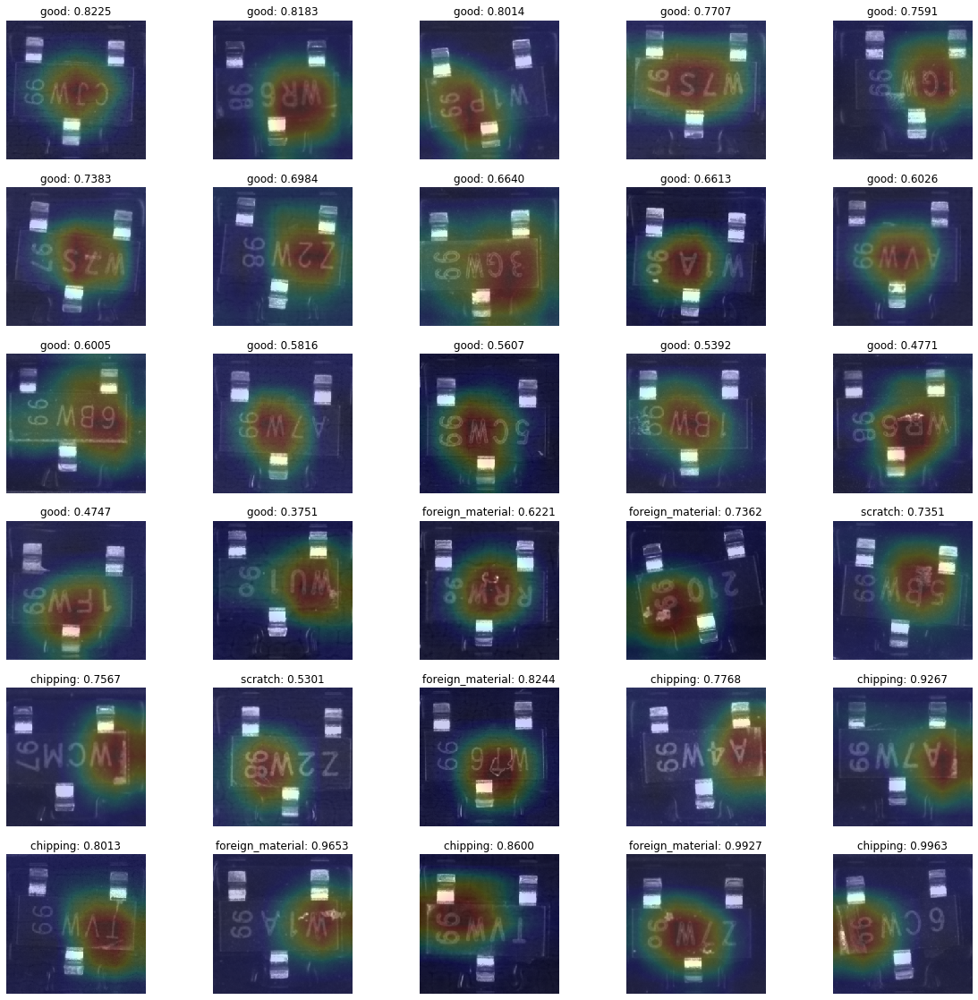

In [79]:
# good low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191003_SOT23_PassImage', image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

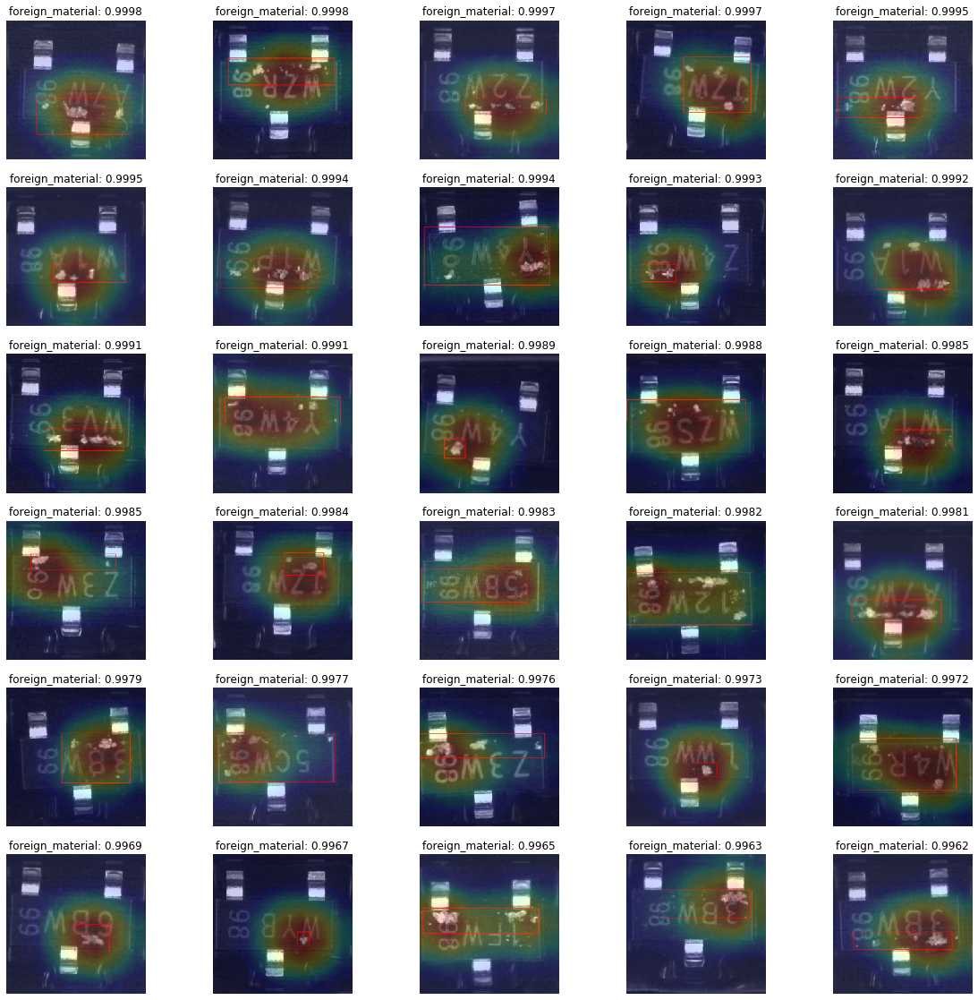

In [71]:
# foreign material high
defect = 3

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

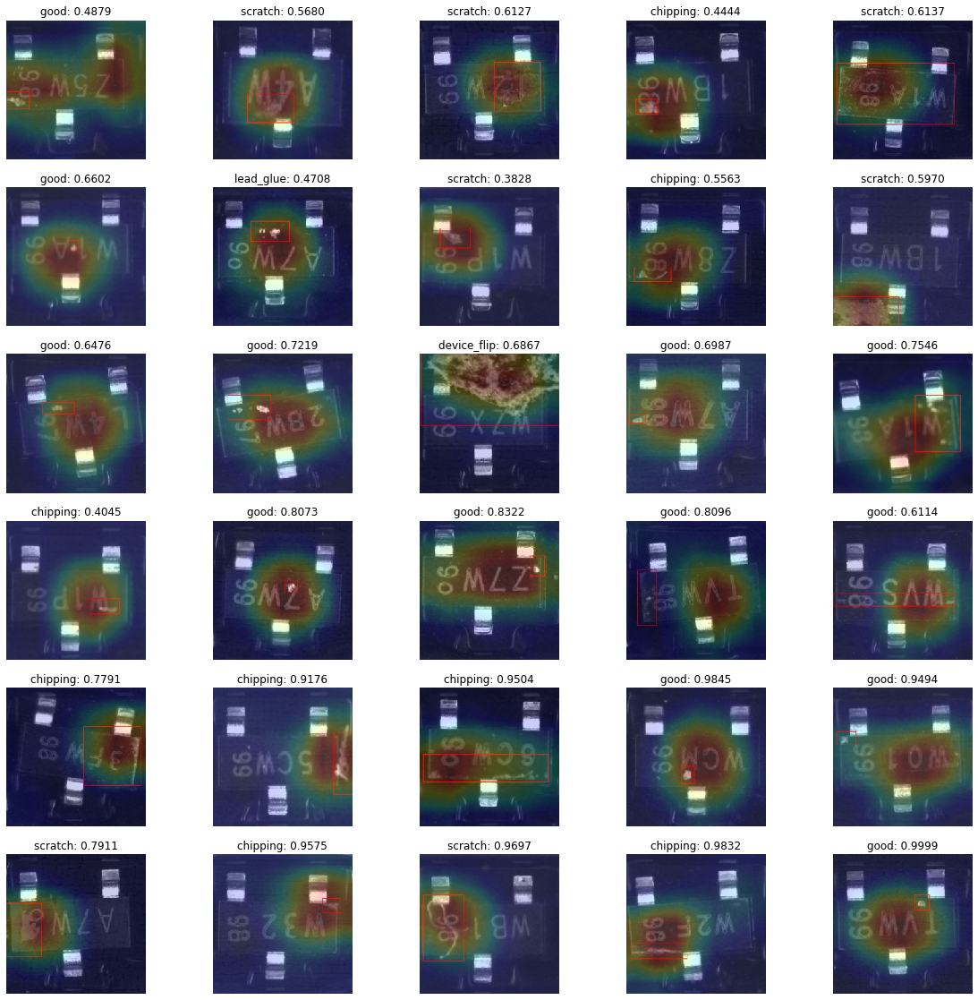

In [73]:
# foreign material low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')

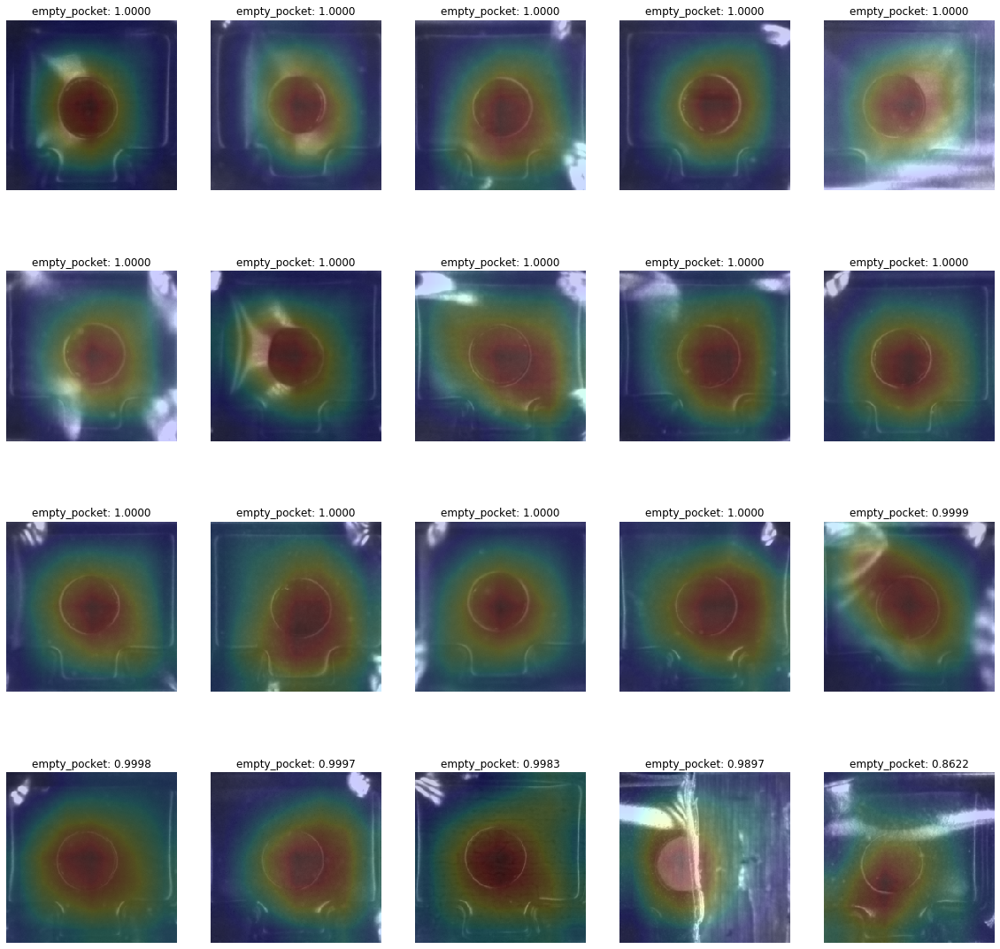

In [70]:
# empty pocket
defect = 2

fig, axs = plt.subplots(4, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(20):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])], torch.max(image_id_dict[class_names[defect]+'_score'][i])))
    axs[i].axis('off')

(0.0, 1.0, 0.0, 1.0)

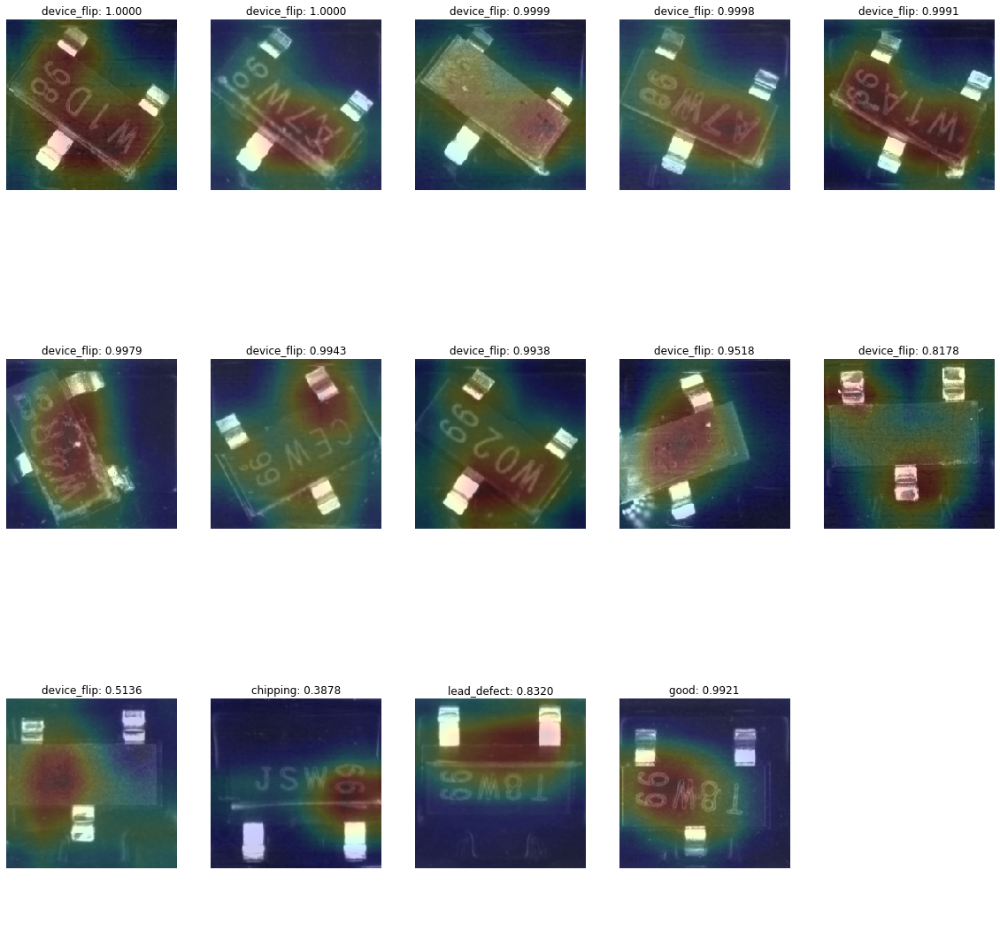

In [66]:
# device flip
defect = 1

fig, axs = plt.subplots(3, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(14):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_score'][i])], torch.max(image_id_dict[class_names[defect]+'_score'][i])))
    axs[i].axis('off')
axs[14].axis('off')

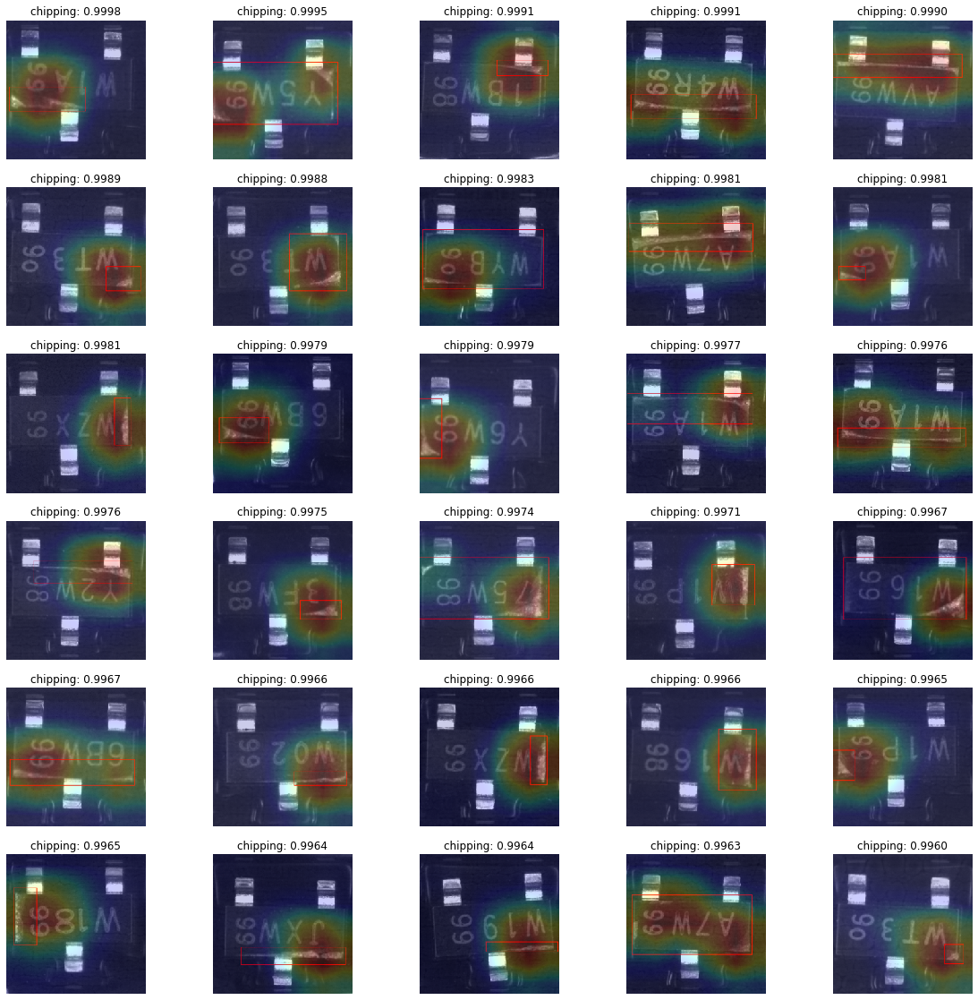

In [74]:
# chipping high
defect = 0

fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_high_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[defect].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[defect], image_id_dict[class_names[defect]+'_high_score'][i,defect]))
    axs[i].axis('off')

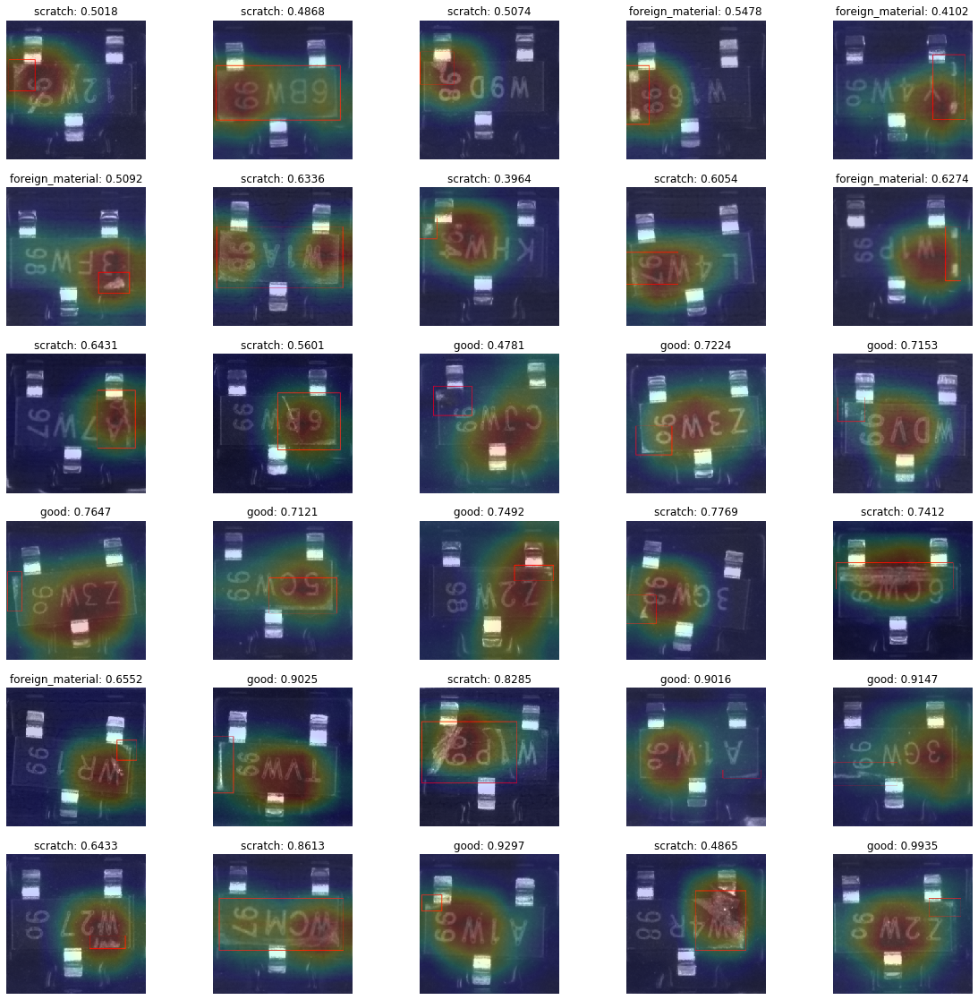

In [75]:
# chipping low
fig, axs = plt.subplots(6, 5, figsize=(20, 20))

axs = axs.ravel()

for i in range(30):
    
    image_path = os.path.join('/home/kaiyihuang/nexperia/new_data/20191129_Labeled_Image', class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i]+'.bmp')
    img = Image.open(image_path).convert('RGB')
    x_1, y_1, x_2, y_2 = defect_details.loc[(class_names[defect], image_id_dict[class_names[defect]+'_low_id'][i])][['x_1', 'y_1', 'x_2', 'y_2']]
    img = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(img)
    draw.rectangle([x_1, y_1, x_2, y_2], outline="red")
    img = data_transforms['test'](img)
    out = plot_cam(model, image_path)
    axs[i].imshow(im(img))
    axs[i].imshow(out[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])].detach().cpu().numpy(), cmap='jet', alpha=0.2)
    axs[i].set_title('{}: {:.4f}'.format(class_names[torch.argmax(image_id_dict[class_names[defect]+'_low_score'][i])], torch.max(image_id_dict[class_names[defect]+'_low_score'][i])))
    axs[i].axis('off')